# Simulation Experiments (Scenarios C and D)
- Goal: Evaluate models on additional simulated settings.
- Flow: Run Scenario C and D loops, aggregate metrics, and compare outputs.


## Data-Generating Process
- Model: Simulate cohort-period outcomes with configurable interaction structure.
- Use: Keep the same evaluation protocol as the main simulation notebook.


In [1]:
import numpy as np
import pandas as pd
import sys, os
from pathlib import Path
sys.path.insert(0, os.path.abspath('..'))

from src.data import simulate_cohort_data2
from src.models.fixed_effects import FixedEffectsModel
from src.models.cohort_period import CohortPeriodModel
from src.models.cohort_period_extended import CohortPeriodExtendedModel
from src.evaluation.metrics import summarise_effect, summarise_extrapolation
from src.evaluation import compute_beta_placebo_te_tables, summarise_placebo_estimands
from src.visualization import *
from src.visualization import (
 plot_placebo_tau_t_by_model_lines_ci,
 plot_placebo_tau_ct_extended_lines_ci,
 plot_placebo_beta_diagnostic_3panel,
 plot_placebo_cohort_trends_3x3,
)

SEEDS  = [0, 1, 2, 3, 4]
N_COHORTS = 20
N_PERIODS = 60
N_REPS  = 1
TRAIN_CUTOFF = N_PERIODS * 3 // 4 - 1

# DGP2 parameters (simple sinusoid)
SF_C, SF_T = 1.0, 0.5
FREQ_T  = 3.5
SF_G  = 4.0
SLOPE_G = 3.0
SN   = 0.3

RESULTS_ROOT = Path('../results')
SIM_ROOT = RESULTS_ROOT / 'simulations'
SIM_ROOT.mkdir(parents=True, exist_ok=True)

print(f"Seeds  : {SEEDS}")
print(f"DGP2   : {N_COHORTS} cohorts × {N_PERIODS} periods × {N_REPS} reps/cell")
print(f"Train/test : 0–{TRAIN_CUTOFF} / {TRAIN_CUTOFF+1}–{N_PERIODS-1} (0-based)")
print(f"Output root : {SIM_ROOT.resolve}")


Seeds  : [0, 1, 2, 3, 4]
DGP2   : 20 cohorts × 60 periods × 1 reps/cell
Train/test : 0–44 / 45–59 (0-based)
Output root : /path/to/your/project 


In [2]:
from pathlib import Path

def _to_numpy(x):
 if hasattr(x, 'detach'):
  return x.detach.cpu.numpy
 return np.asarray(x)

def _seed_dgp_report_lines(data, scenario_label):
 hp = data['hyperparams']
 alpha_true = _to_numpy(data['alpha_true'])
 beta_true = _to_numpy(data['beta_true'])
 gamma_true = _to_numpy(data['gamma_true'])
 obs_c = _to_numpy(data['obs_c']).astype(int)
 obs_t = _to_numpy(data['obs_t']).astype(int)
 y = _to_numpy(data['y']).astype(float)
 obs_df = pd.DataFrame({'obs_c': obs_c, 'obs_t': obs_t, 'y': y})

 lines = [
  f'Scenario: {scenario_label}',
  f'Seed: {data["seed"]}',
  f'Grid: C={data["n_cohorts"]}, T={data["n_periods"]}, R={data["n_reps"]}',
  f'Interaction in DGP: {bool(data["interaction"])}',
  f'Number of observations (N): {len(obs_df)}',
  '',
  'True DGP parameters:',
 ]
 for k, v in hp.items:
  lines.append(f' {k}: {v}')
 lines += [
  '',
  f'sum(alpha_true)={alpha_true.sum:.6e}',
  f'sum(beta_true)={beta_true.sum:.6e}',
  f'max|row-sum(gamma_true)|={np.abs(gamma_true.sum(axis=1)).max:.6e}',
  f'max|col-sum(gamma_true)|={np.abs(gamma_true.sum(axis=0)).max:.6e}',
  '',
  'Sample observations (head):',
  obs_df.head(10).to_string(index=False),
 ]
 return lines

def _write_seed_dgp_report(data, scenario_label, out_path):
 lines = _seed_dgp_report_lines(data, scenario_label)
 Path(out_path).write_text('\n'.join(lines) + '\n')

def _build_fit_rows(model_label, model_out, data, include_gamma=False):
 rows = []
 alpha_true = _to_numpy(data['alpha_true'])
 beta_true = _to_numpy(data['beta_true'])

 alpha_hat = np.asarray(model_out['alpha'])
 beta_hat = np.asarray(model_out['beta'])
 lo_a = np.asarray(model_out['lo95_alpha'])
 hi_a = np.asarray(model_out['hi95_alpha'])
 lo_b = np.asarray(model_out['lo95_beta'])
 hi_b = np.asarray(model_out['hi95_beta'])

 for i in range(len(alpha_hat)):
  rows.append({'model': model_label, 'effect_type': 'alpha', 'index': int(i),
      'mean': float(alpha_hat[i]), 'lo95': float(lo_a[i]), 'hi95': float(hi_a[i]),
      'truth': float(alpha_true[i])})

 for t in range(len(beta_hat)):
  rows.append({'model': model_label, 'effect_type': 'beta', 'index': int(t),
      'mean': float(beta_hat[t]), 'lo95': float(lo_b[t]), 'hi95': float(hi_b[t]),
      'truth': float(beta_true[t])})

 if include_gamma and 'gamma' in model_out:
  gamma_true = _to_numpy(data['gamma_true'])
  gamma_hat = np.asarray(model_out['gamma'])
  lo_g = np.asarray(model_out.get('lo95_gamma', np.full_like(gamma_hat, np.nan)))
  hi_g = np.asarray(model_out.get('hi95_gamma', np.full_like(gamma_hat, np.nan)))
  for c in range(gamma_hat.shape[0]):
   for t in range(gamma_hat.shape[1]):
    rows.append({'model': model_label, 'effect_type': 'gamma', 'index': int(c * gamma_hat.shape[1] + t),
        'mean': float(gamma_hat[c, t]), 'lo95': float(lo_g[c, t]), 'hi95': float(hi_g[c, t]),
        'truth': float(gamma_true[c, t])})

 return rows

def _build_seed_fit_metrics(fit_df):
 out = []
 for (model, effect_type), sub in fit_df.groupby(['model', 'effect_type']):
  m = summarise_effect(
   mean=sub['mean'].to_numpy,
   lo95=sub['lo95'].to_numpy,
   hi95=sub['hi95'].to_numpy,
   truth=sub['truth'].to_numpy,
  )
  m['CI_Width'] = float(np.mean(sub['hi95'].to_numpy - sub['lo95'].to_numpy))
  for metric_name, value in m.items:
   out.append({'model': model, 'effect_type': effect_type, 'metric': metric_name, 'value': float(value)})

 for model in ['FE+AR', 'GP-CP']:
  for metric_name in ['Bias', 'RMSE', 'Coverage']:
   out.append({'model': model, 'effect_type': 'gamma', 'metric': metric_name, 'value': np.nan})

 return pd.DataFrame(out)

def _fit_models_full_data(data, use_global_mean=False):
 y = data['y']
 obs_c = data['obs_c']
 obs_t = data['obs_t']
 c = data['n_cohorts']
 t = data['n_periods']
 seed = data['seed']
 hp = data['hyperparams']

 fe = FixedEffectsModel(use_global_mean=use_global_mean).fit(
  y=y, obs_c=obs_c, obs_t=obs_t, n_cohorts=c, n_periods=t, seed=seed, true_hyperparams=hp
 )
 cp = CohortPeriodModel(use_global_mean=use_global_mean).fit(
  y=y, obs_c=obs_c, obs_t=obs_t, n_cohorts=c, n_periods=t, seed=seed, true_hyperparams=hp
 )
 ext = CohortPeriodExtendedModel(use_global_mean=use_global_mean).fit(
  y=y, obs_c=obs_c, obs_t=obs_t, n_cohorts=c, n_periods=t, seed=seed, true_hyperparams=hp
 )

 return {
  'FE+AR': fe.results_dict,
  'GP-CP': cp.results_dict,
  'GP-CP-Extended': ext.results_dict,
 }

def _fit_info_for_plots(data, fitted_dict):
 y_true = _to_numpy(data['y'])
 out = {'gamma_true': _to_numpy(data['gamma_true'])}
 for m, d in fitted_dict.items:
  out[m] = {
   'mu': d.get('mu', 0.0),
   'alpha': np.asarray(d.get('alpha')),
   'beta': np.asarray(d.get('beta')),
   'gamma': np.asarray(d.get('gamma')),
   'y_true': y_true,
   'y_hat': np.asarray(d.get('y_hat')),
   'resid': np.asarray(d.get('resid')),
   'gamma_true': _to_numpy(data['gamma_true']),
  }
 return out

def _scenario_seed_dir(scenario: str, seed: int) -> Path:
 return simulation_seed_output_dir(Path('../results'), scenario=scenario, seed=seed, create=True)


## Scenario C
- Step: Run fitting, extrapolation, and placebo workflow across seeds.
- Save: Scenario C per-seed results and aggregated summaries.


Figure saved →../results/simulations/C/0/dgp_overview_seed0.pdf
Figure saved ->../results/simulations/C/0/scenC_seed0_effect_recovery.pdf
[C-1] seed=0: done
Figure saved →../results/simulations/C/1/dgp_overview_seed1.pdf
Figure saved ->../results/simulations/C/1/scenC_seed1_effect_recovery.pdf
[C-1] seed=1: done
Figure saved →../results/simulations/C/2/dgp_overview_seed2.pdf
Figure saved ->../results/simulations/C/2/scenC_seed2_effect_recovery.pdf
[C-1] seed=2: done
Figure saved →../results/simulations/C/3/dgp_overview_seed3.pdf
Figure saved ->../results/simulations/C/3/scenC_seed3_effect_recovery.pdf
[C-1] seed=3: done
Figure saved →../results/simulations/C/4/dgp_overview_seed4.pdf
Figure saved ->../results/simulations/C/4/scenC_seed4_effect_recovery.pdf
[C-1] seed=4: done
Figure saved ->../results/simulations/summary_scenC_fit.pdf
C-1 summary written


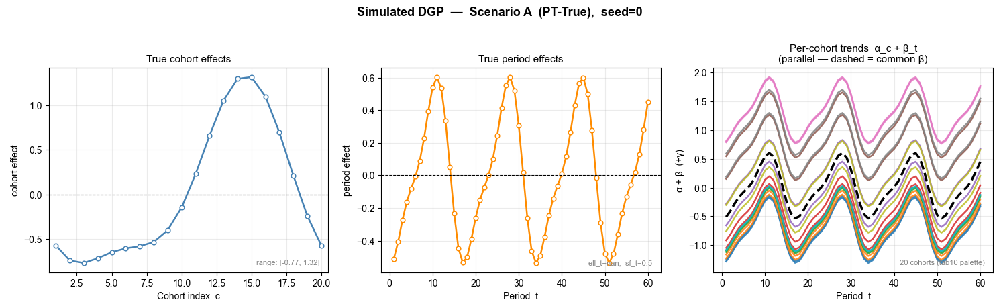

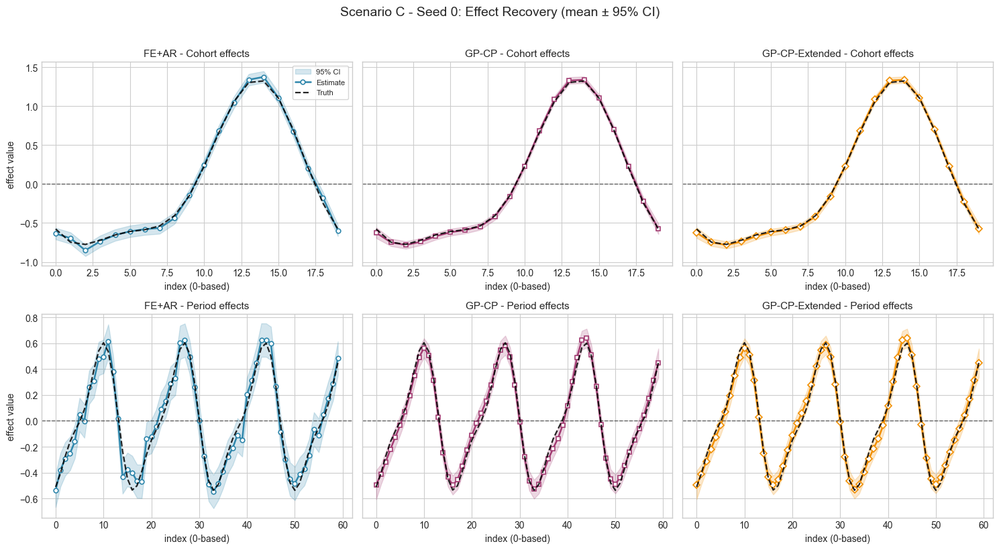

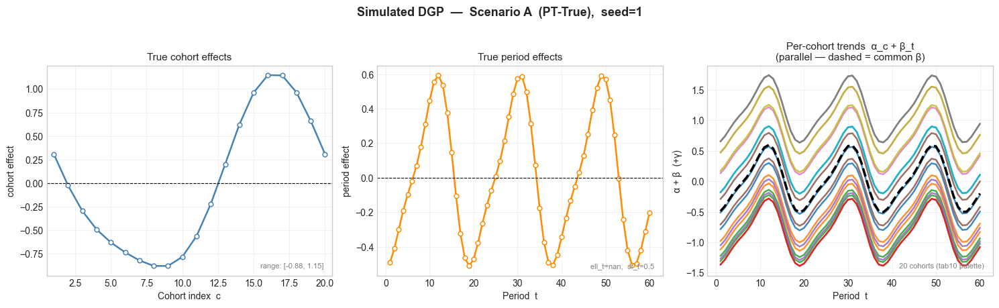

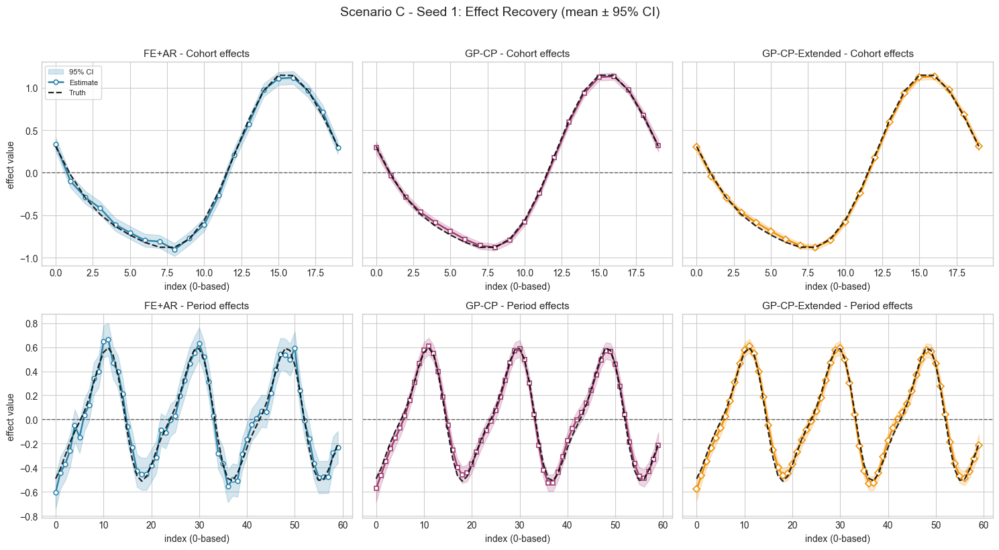

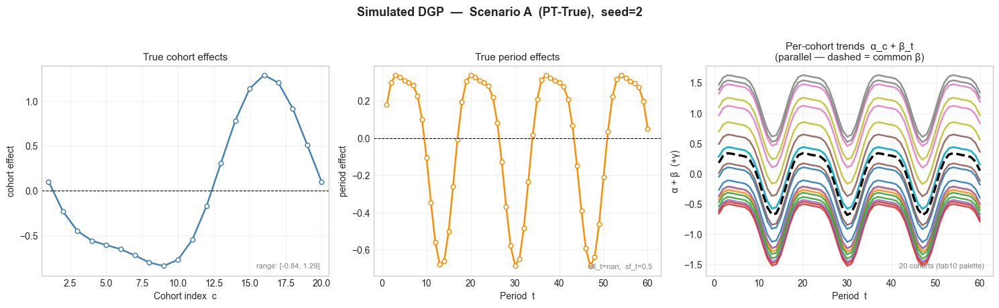

...

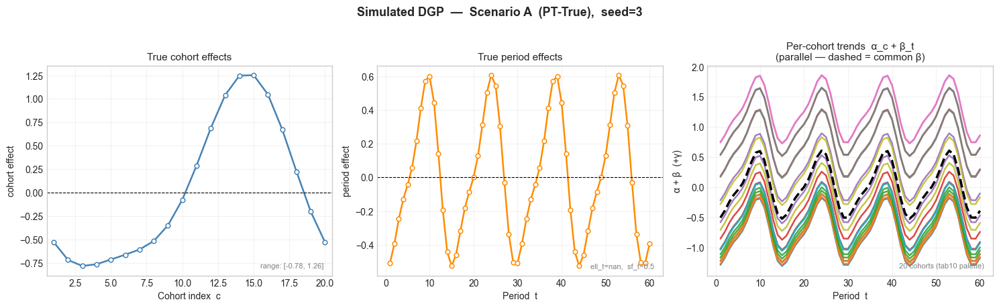

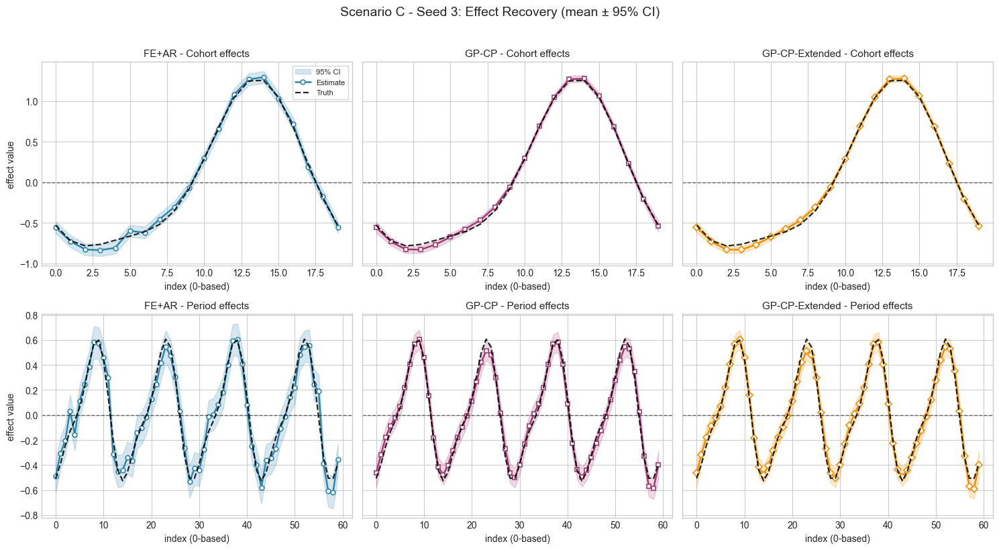

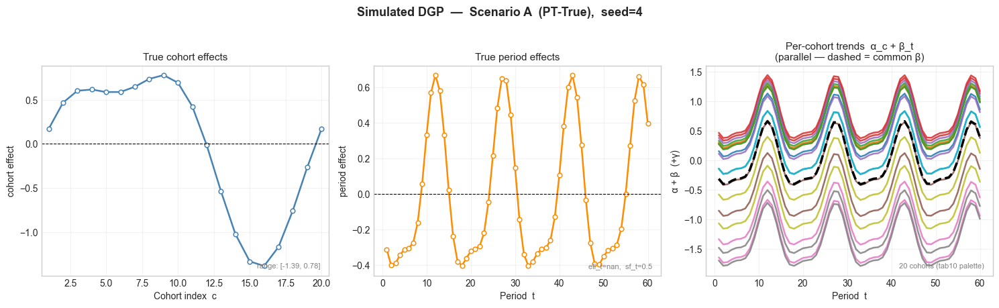

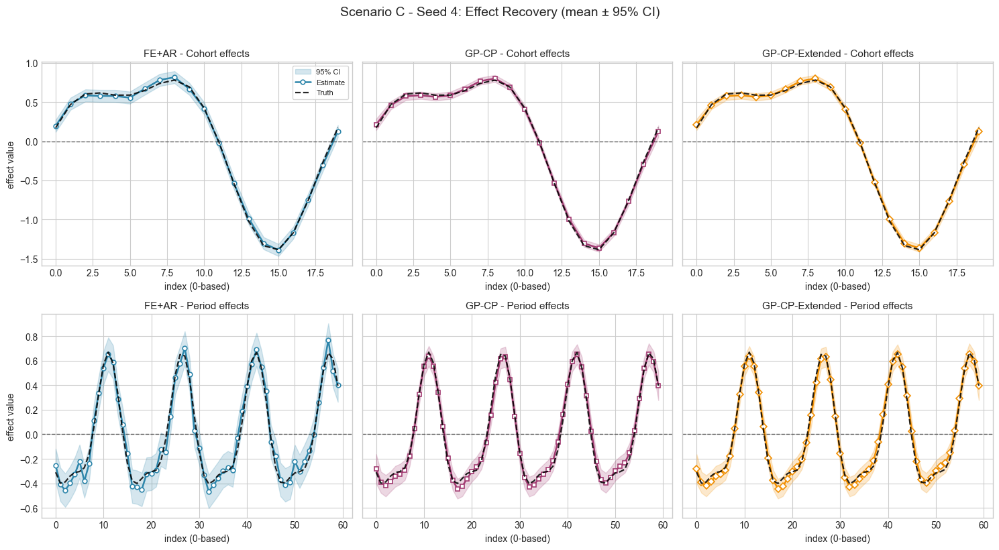

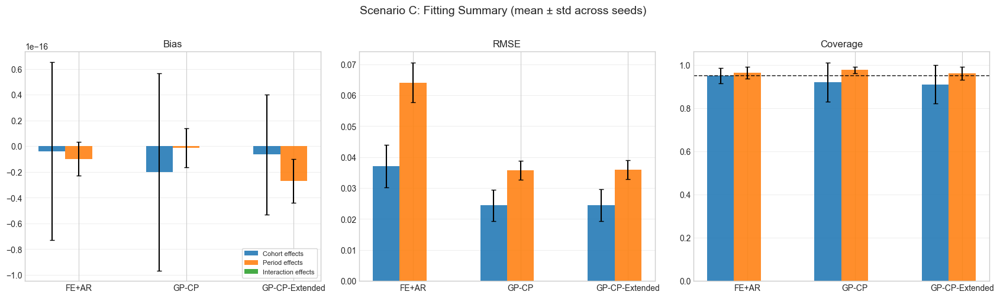

In [3]:
# C-1: full-data fit
scenC_fit_records = []
scenC_metric_records = []

for seed in SEEDS:
 data = simulate_cohort_data2(
  n_cohorts=N_COHORTS, n_periods=N_PERIODS, n_reps=N_REPS,
  sf_c=SF_C, sf_t=SF_T, freq_t=FREQ_T,
  sf_g=SF_G, slope_g=SLOPE_G,
  sn=SN, interaction=False, seed=seed,
 )

 seed_dir = _scenario_seed_dir('C', seed)
 _write_seed_dgp_report(data, scenario_label='C', out_path=seed_dir / f'dgp_report_seed{seed}.txt')
 plot_simulated_data(data, print_config=False, save_path=str(seed_dir / f'dgp_overview_seed{seed}.pdf'))

 fitted = _fit_models_full_data(data, use_global_mean=False)
 seed_rows = []
 for model_label, model_out in fitted.items:
  seed_rows.extend(_build_fit_rows(model_label, model_out, data, include_gamma=False))
 seed_df = pd.DataFrame(seed_rows)
 seed_df.to_csv(seed_dir / f'scenC_fit_seed{seed}.csv', index=False)

 seed_metrics = _build_seed_fit_metrics(seed_df)
 seed_metrics.to_csv(seed_dir / f'scenC_fit_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenC_fit_metrics_seed{seed}.txt').write_text(seed_metrics.to_string(index=False) + '\n')

 fit_info = _fit_info_for_plots(data, fitted)
 model_cmp_df, residual_df = build_comparison_tables(fit_info, include_interaction=False)
 model_cmp_df.to_csv(seed_dir / f'model_fit_summary_seed{seed}.csv', index=False)
 residual_df.to_csv(seed_dir / f'residual_summary_seed{seed}.csv', index=False)

 plot_effect_recovery(seed_df, scenario='C', seed=seed, fit_info=fit_info,
       save_path=str(seed_dir / f'scenC_seed{seed}_effect_recovery.pdf'))

 scenC_fit_records.append(seed_df.assign(seed=seed))
 scenC_metric_records.append(seed_metrics.assign(seed=seed))
 print(f'[C-1] seed={seed}: done')

scenC_fit_metrics_all = pd.concat(scenC_metric_records, ignore_index=True)
summary_scenC_fit = (
 scenC_fit_metrics_all
.groupby(['model', 'effect_type', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenC_fit.to_csv(SIM_ROOT / 'summary_scenC_fit.csv', index=False)
plot_scenario_fit_summary(summary_scenC_fit, scenario='C', save_path=str(SIM_ROOT / 'summary_scenC_fit.pdf'))
print('C-1 summary written')


Figure saved ->../results/simulations/C/0/scenC_seed0_placebo_tau_t.pdf
Figure saved ->../results/simulations/C/0/scenC_seed0_placebo_tau_ct.pdf
Figure saved ->../results/simulations/C/0/scenC_seed0_placebo_beta_diag.pdf
Figure saved ->../results/simulations/C/0/scenC_seed0_placebo_cohort_trends_3x3.pdf
Figure saved ->../results/simulations/C/0/scenC_seed0_extrapolation_beta.pdf
Figure saved ->../results/simulations/C/0/scenC_seed0_extrapolation_y.pdf
[C-2/3/4] seed=0: done
Figure saved ->../results/simulations/C/1/scenC_seed1_placebo_tau_t.pdf
Figure saved ->../results/simulations/C/1/scenC_seed1_placebo_tau_ct.pdf
Figure saved ->../results/simulations/C/1/scenC_seed1_placebo_beta_diag.pdf
Figure saved ->../results/simulations/C/1/scenC_seed1_placebo_cohort_trends_3x3.pdf
Figure saved ->../results/simulations/C/1/scenC_seed1_extrapolation_beta.pdf
Figure saved ->../results/simulations/C/1/scenC_seed1_extrapolation_y.pdf
[C-2/3/4] seed=1: done
Figure saved ->../results/simulations/C/2/

/path/to/your/project RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close`.
 fig, axes = plt.subplots(1, len(present), figsize=(5.4 * len(present), 4.8), sharey=True)


Figure saved ->../results/simulations/C/3/scenC_seed3_placebo_beta_diag.pdf
Figure saved ->../results/simulations/C/3/scenC_seed3_placebo_cohort_trends_3x3.pdf
Figure saved ->../results/simulations/C/3/scenC_seed3_extrapolation_beta.pdf
Figure saved ->../results/simulations/C/3/scenC_seed3_extrapolation_y.pdf
[C-2/3/4] seed=3: done
Figure saved ->../results/simulations/C/4/scenC_seed4_placebo_tau_t.pdf
Figure saved ->../results/simulations/C/4/scenC_seed4_placebo_tau_ct.pdf
Figure saved ->../results/simulations/C/4/scenC_seed4_placebo_beta_diag.pdf
Figure saved ->../results/simulations/C/4/scenC_seed4_placebo_cohort_trends_3x3.pdf
Figure saved ->../results/simulations/C/4/scenC_seed4_extrapolation_beta.pdf
Figure saved ->../results/simulations/C/4/scenC_seed4_extrapolation_y.pdf
[C-2/3/4] seed=4: done
C extrap summaries written


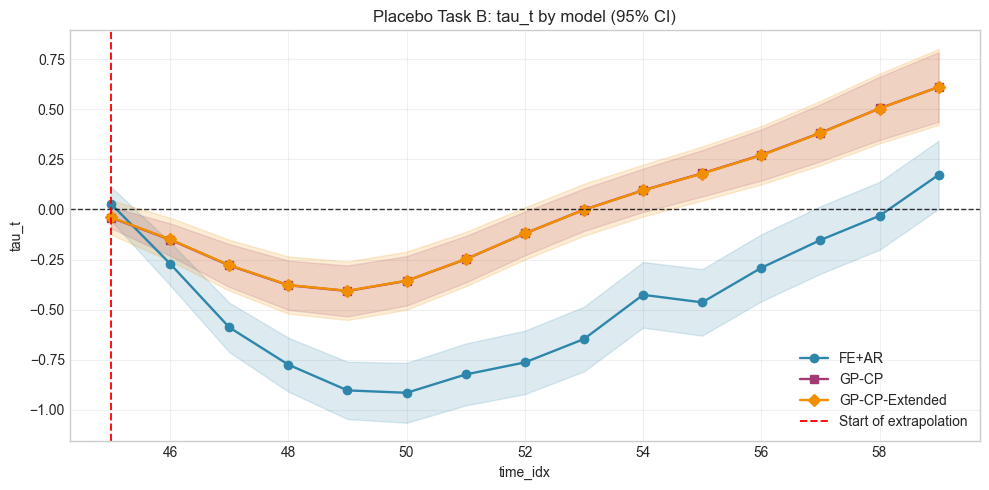

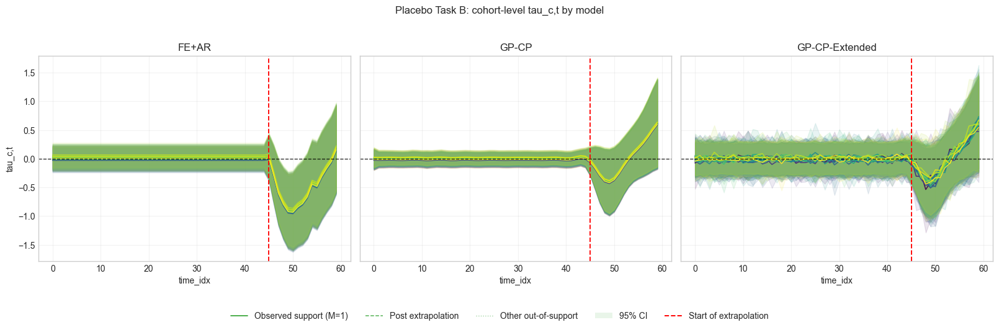

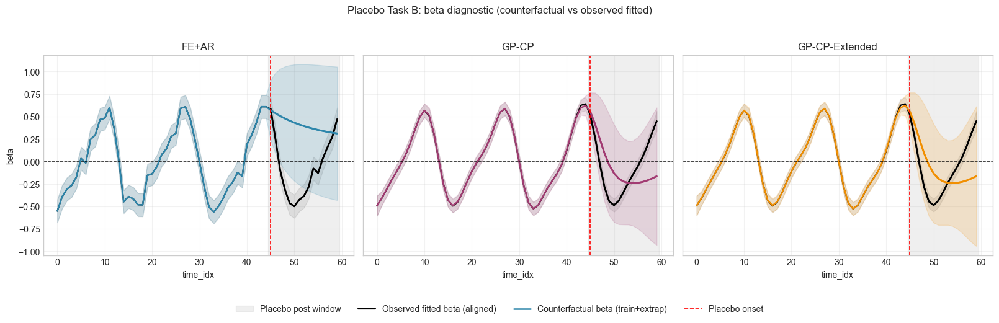

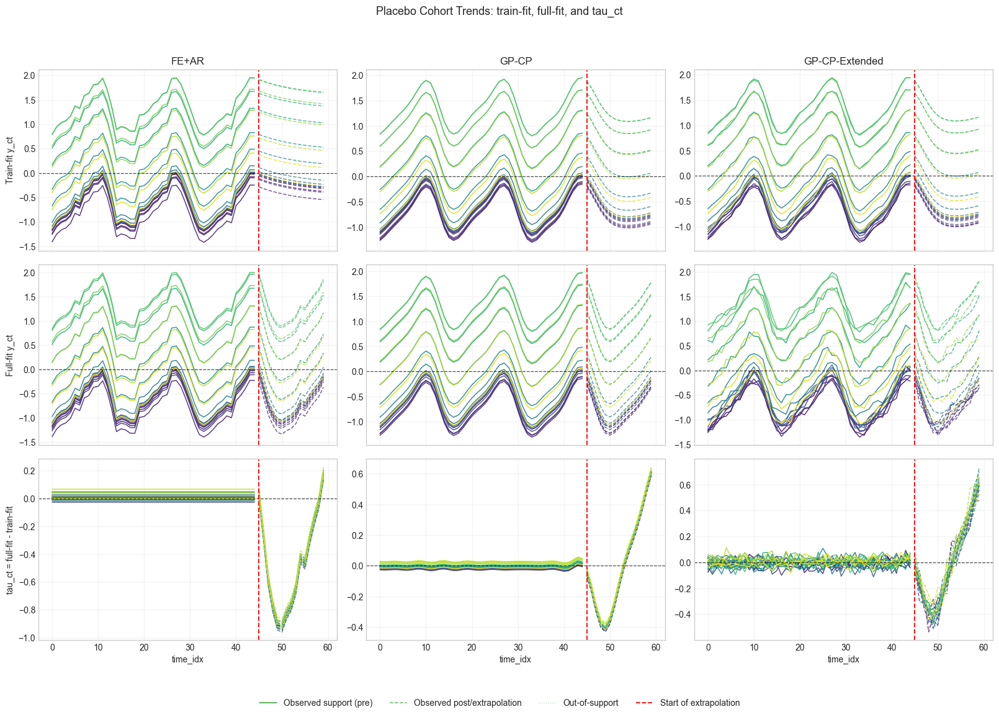

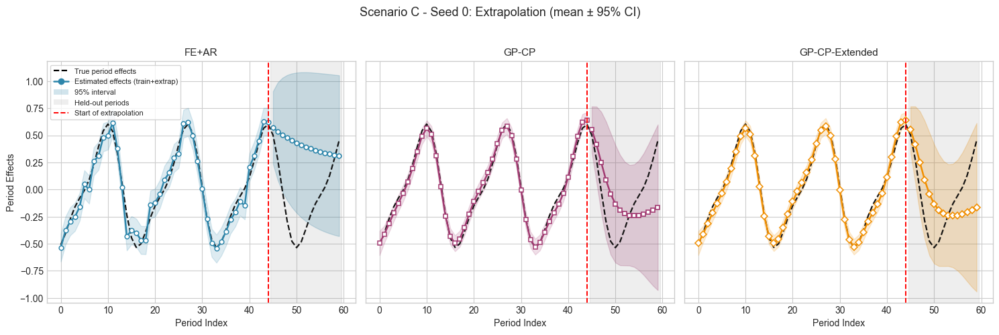

...

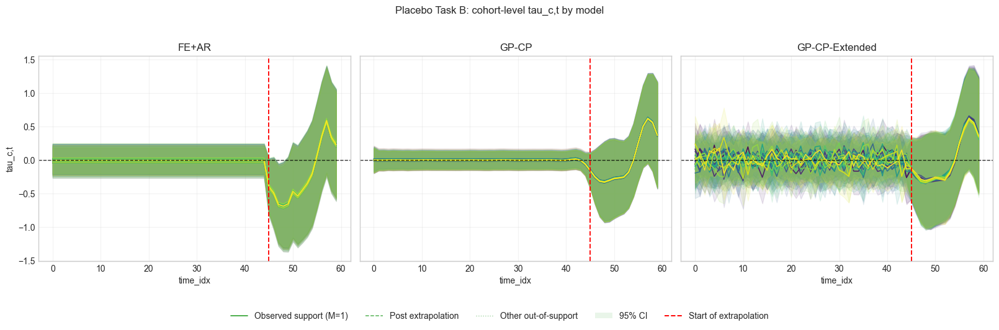

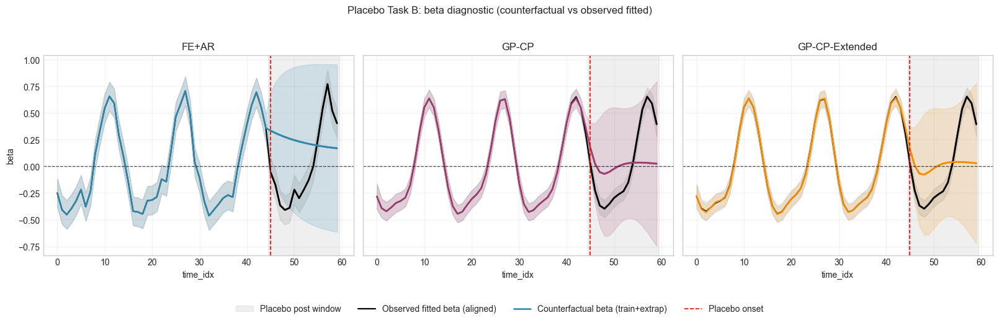

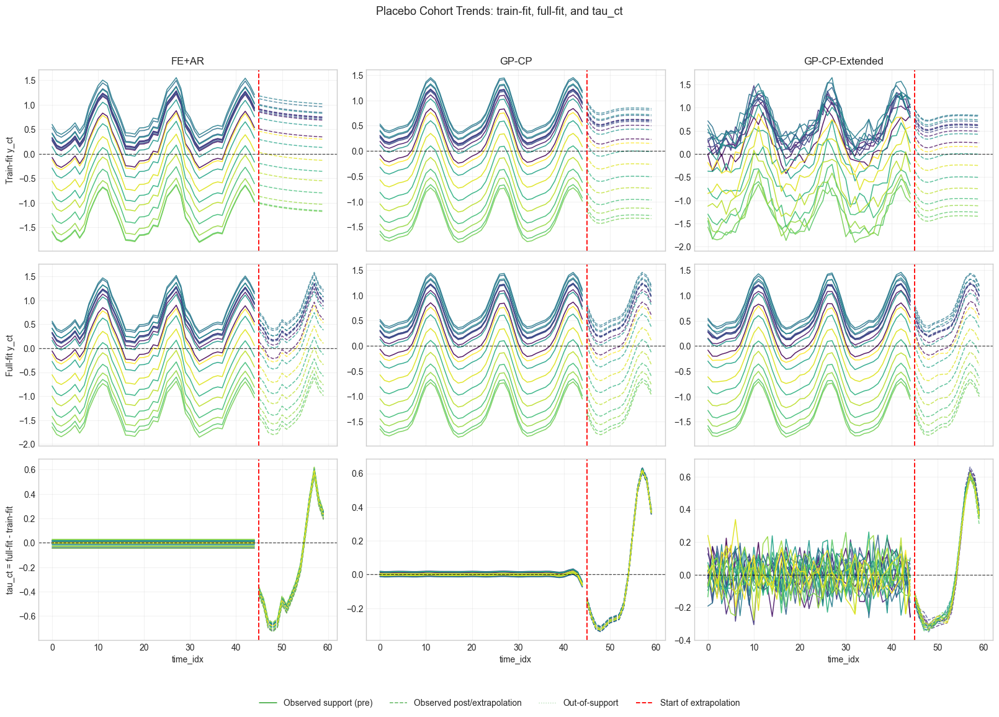

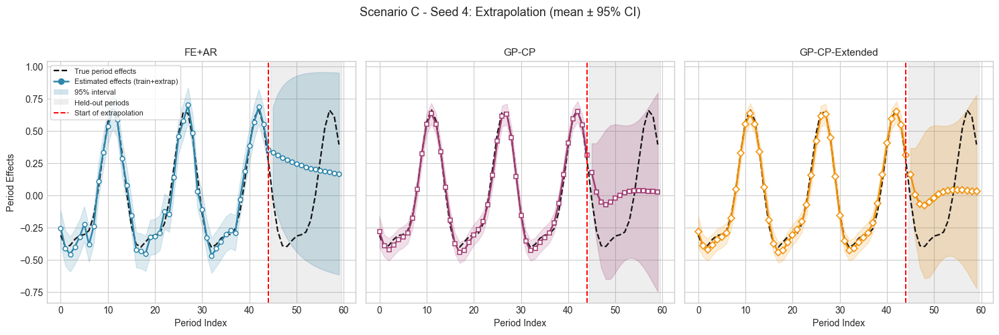

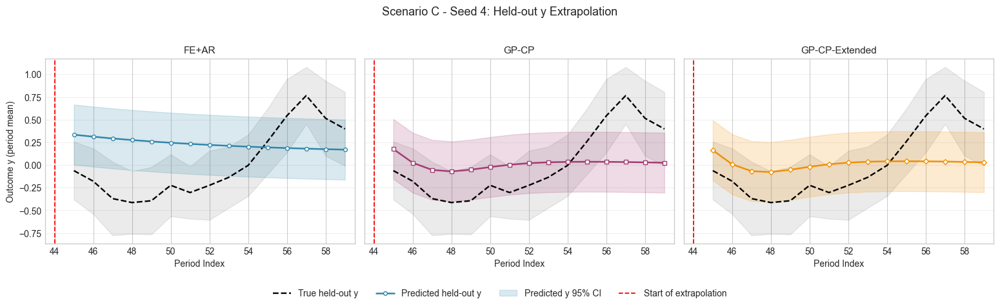

In [4]:
# C-2: extrapolation + C-3/C-4 artifacts
scenC_extrap_metric_records = []
scenC_extrap_y_metric_records = []
scenC_placebo_metric_records = []

for seed in SEEDS:
 data = simulate_cohort_data2(
  n_cohorts=N_COHORTS, n_periods=N_PERIODS, n_reps=N_REPS,
  sf_c=SF_C, sf_t=SF_T, freq_t=FREQ_T,
  sf_g=SF_G, slope_g=SLOPE_G,
  sn=SN, interaction=False, seed=seed,
 )
 seed_dir = _scenario_seed_dir('C', seed)

 obs_t = _to_numpy(data['obs_t']).astype(int)
 obs_c = _to_numpy(data['obs_c']).astype(int)
 y_all = _to_numpy(data['y']).astype(float)
 train_mask = obs_t <= TRAIN_CUTOFF
 test_mask = ~train_mask

 y_tr = y_all[train_mask]
 c_tr = obs_c[train_mask]
 t_tr = obs_t[train_mask]

 y_test = y_all[test_mask]
 c_test = obs_c[test_mask]
 t_test = obs_t[test_mask]

 t_train = TRAIN_CUTOFF + 1
 test_periods = np.arange(t_train, N_PERIODS, dtype=int)
 n_extrap = len(test_periods)
 beta_true_full = _to_numpy(data['beta_true'])
 beta_true_test = beta_true_full[test_periods]
 hp = data['hyperparams']

 fe = FixedEffectsModel(use_global_mean=False).fit(
  y=y_tr, obs_c=c_tr, obs_t=t_tr, n_cohorts=N_COHORTS, n_periods=t_train,
  seed=seed, true_hyperparams=hp,
 )
 fe_mean, fe_std = fe.extrapolate(n_extrap)

 cp = CohortPeriodModel(use_global_mean=False).fit(
  y=y_tr, obs_c=c_tr, obs_t=t_tr, n_cohorts=N_COHORTS, n_periods=N_PERIODS,
  seed=seed, true_hyperparams=hp,
 ).results_dict
 ext = CohortPeriodExtendedModel(use_global_mean=False).fit(
  y=y_tr, obs_c=c_tr, obs_t=t_tr, n_cohorts=N_COHORTS, n_periods=N_PERIODS,
  seed=seed, true_hyperparams=hp,
 ).results_dict

 model_preds = {
  'FE+AR': {'mean': np.asarray(fe_mean), 'std': np.asarray(fe_std)},
  'GP-CP': {'mean': np.asarray(cp['beta'])[test_periods], 'std': np.asarray(cp['std_beta'])[test_periods]},
  'GP-CP-Extended': {'mean': np.asarray(ext['beta'])[test_periods], 'std': np.asarray(ext['std_beta'])[test_periods]},
 }

 rows, metrics = [], []
 for model_label, pred in model_preds.items:
  mean = pred['mean']; std = pred['std']
  lo95 = mean - 1.96 * std; hi95 = mean + 1.96 * std
  for k, t in enumerate(test_periods):
   rows.append({'model': model_label, 'period': int(t), 'mean': float(mean[k]),
       'lo95': float(lo95[k]), 'hi95': float(hi95[k]), 'truth': float(beta_true_test[k])})
  m = summarise_extrapolation(pred_mean=mean, truth=beta_true_test)
  m['Coverage'] = float(np.mean((lo95 <= beta_true_test) & (beta_true_test <= hi95)))
  m['CI_Width'] = float(np.mean(hi95 - lo95))
  for metric_name, value in m.items:
   metrics.append({'model': model_label, 'metric': metric_name, 'value': float(value)})

 # Placebo TE on extrapolation window (truth is 0; simulation support M=1)
 model_order = ['FE+AR', 'GP-CP', 'GP-CP-Extended']
 support_mask_sim = np.ones((N_COHORTS, N_PERIODS), dtype=bool)

 fe_train_beta = np.concatenate([np.asarray(fe.beta_, dtype=float), np.asarray(fe_mean, dtype=float)])
 fe_train_beta_std = np.concatenate([np.asarray(fe.std_beta_, dtype=float), np.asarray(fe_std, dtype=float)])
 train_fit = {
  'FE+AR': {
   'mu': float(fe.mu_),
   'alpha': np.asarray(fe.alpha_, dtype=float),
   'beta': fe_train_beta,
   'std_alpha': np.asarray(fe.std_alpha_, dtype=float),
   'std_beta': fe_train_beta_std,
   'gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
   'std_gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
  },
  'GP-CP': {
   'mu': float(cp.get('mu', 0.0)),
   'alpha': np.asarray(cp['alpha'], dtype=float),
   'beta': np.asarray(cp['beta'], dtype=float),
   'std_alpha': np.asarray(cp.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(cp.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(cp.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(cp.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
  'GP-CP-Extended': {
   'mu': float(ext.get('mu', 0.0)),
   'alpha': np.asarray(ext['alpha'], dtype=float),
   'beta': np.asarray(ext['beta'], dtype=float),
   'std_alpha': np.asarray(ext.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(ext.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(ext.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(ext.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
 }

 fe_full = FixedEffectsModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 )
 cp_full = CohortPeriodModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict
 ext_full = CohortPeriodExtendedModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict

 full_fit = {
  'FE+AR': {
   'mu': float(fe_full.mu_),
   'alpha': np.asarray(fe_full.alpha_, dtype=float),
   'beta': np.asarray(fe_full.beta_, dtype=float),
   'std_alpha': np.asarray(fe_full.std_alpha_, dtype=float),
   'std_beta': np.asarray(fe_full.std_beta_, dtype=float),
   'gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
   'std_gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
  },
  'GP-CP': {
   'mu': float(cp_full.get('mu', 0.0)),
   'alpha': np.asarray(cp_full['alpha'], dtype=float),
   'beta': np.asarray(cp_full['beta'], dtype=float),
   'std_alpha': np.asarray(cp_full.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(cp_full.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(cp_full.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(cp_full.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
  'GP-CP-Extended': {
   'mu': float(ext_full.get('mu', 0.0)),
   'alpha': np.asarray(ext_full['alpha'], dtype=float),
   'beta': np.asarray(ext_full['beta'], dtype=float),
   'std_alpha': np.asarray(ext_full.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(ext_full.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(ext_full.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(ext_full.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
 }

 tau_t_df, tau_ct_df, _ = compute_beta_placebo_te_tables(
  category=f'scenC_seed{seed}',
  train_fit=train_fit,
  full_fit=full_fit,
  n_t_tr=t_train,
  n_t=N_PERIODS,
  n_c=N_COHORTS,
  support_mask=support_mask_sim,
  model_order=model_order,
 )
 te_summary_df = summarise_placebo_estimands(
  category=f'scenC_seed{seed}',
  tau_ct_df=tau_ct_df,
  tau_t_df=tau_t_df,
  model_order=model_order,
 )
 placebo_long_df = te_summary_df.melt(id_vars=['category', 'model'], var_name='metric', value_name='value')

 tau_t_df.to_csv(seed_dir / f'scenC_placebo_tau_t_seed{seed}.csv', index=False)
 tau_ct_df.to_csv(seed_dir / f'scenC_placebo_tau_ct_seed{seed}.csv', index=False)
 te_summary_df.to_csv(seed_dir / f'scenC_placebo_summary_seed{seed}.csv', index=False)
 placebo_long_df.to_csv(seed_dir / f'scenC_placebo_metrics_long_seed{seed}.csv', index=False)

 plot_placebo_tau_t_by_model_lines_ci(
  tau_t_df=tau_t_df,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  save_path=str(seed_dir / f'scenC_seed{seed}_placebo_tau_t.pdf'),
 )
 plot_placebo_tau_ct_extended_lines_ci(
  tau_ct_df=tau_ct_df,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  save_path=str(seed_dir / f'scenC_seed{seed}_placebo_tau_ct.pdf'),
 )
 plot_placebo_beta_diagnostic_3panel(
  train_fit=train_fit,
  full_fit=full_fit,
  n_t_tr=t_train,
  n_t=N_PERIODS,
  model_order=model_order,
  save_path=str(seed_dir / f'scenC_seed{seed}_placebo_beta_diag.pdf'),
 )
 plot_placebo_cohort_trends_3x3(
  train_fit=train_fit,
  full_fit=full_fit,
  support_mask=support_mask_sim,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  extrapolation_start_idx=t_train,
  save_path=str(seed_dir / f'scenC_seed{seed}_placebo_cohort_trends_3x3.pdf'),
 )

 y_pred = {
  'FE+AR': fe.mu_ + fe.alpha_[c_test] + np.asarray(fe_mean, dtype=float)[t_test - t_train],
  'GP-CP': float(cp.get('mu', 0.0)) + np.asarray(cp['alpha'])[c_test] + np.asarray(cp['beta'])[t_test] + np.asarray(cp['gamma'])[c_test, t_test],
  'GP-CP-Extended': float(ext.get('mu', 0.0)) + np.asarray(ext['alpha'])[c_test] + np.asarray(ext['beta'])[t_test] + np.asarray(ext['gamma'])[c_test, t_test],
 }

 y_rows, y_metrics = [], []
 for model_label, yh in y_pred.items:
  resid = yh - y_test
  for i in range(len(y_test)):
   y_rows.append({'model': model_label, 'cohort': int(c_test[i]), 'period': int(t_test[i]),
       'y_true': float(y_test[i]), 'y_hat': float(yh[i]), 'resid': float(resid[i])})
  y_metrics.extend([
   {'model': model_label, 'metric': 'Bias', 'value': float(np.mean(resid))},
   {'model': model_label, 'metric': 'MAE', 'value': float(np.mean(np.abs(resid)))},
   {'model': model_label, 'metric': 'RMSE', 'value': float(np.sqrt(np.mean(resid ** 2)))},
  ])

 extrap_df = pd.DataFrame(rows)
 metrics_df = pd.DataFrame(metrics)
 y_df = pd.DataFrame(y_rows)
 y_metrics_df = pd.DataFrame(y_metrics)

 extrap_df.to_csv(seed_dir / f'scenC_extrap_seed{seed}.csv', index=False)
 metrics_df.to_csv(seed_dir / f'scenC_extrap_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenC_extrap_metrics_seed{seed}.txt').write_text(metrics_df.to_string(index=False) + '\n')

 y_df.to_csv(seed_dir / f'scenC_extrap_y_seed{seed}.csv', index=False)
 y_metrics_df.to_csv(seed_dir / f'scenC_extrap_y_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenC_extrap_y_metrics_seed{seed}.txt').write_text(y_metrics_df.to_string(index=False) + '\n')

 fit_df = pd.read_csv(seed_dir / f'scenC_fit_seed{seed}.csv')
 plot_extrapolation(fit_df=fit_df, extrap_df=extrap_df, beta_true_full=beta_true_full,
      train_cutoff=TRAIN_CUTOFF, scenario='C', seed=seed,
      save_path=str(seed_dir / f'scenC_seed{seed}_extrapolation_beta.pdf'))
 plot_extrapolation_y(extrap_y_df=y_df, train_cutoff=TRAIN_CUTOFF, scenario='C', seed=seed,
       save_path=str(seed_dir / f'scenC_seed{seed}_extrapolation_y.pdf'))

 seed_fit_metrics = pd.read_csv(seed_dir / f'scenC_fit_metrics_seed{seed}.csv').assign(task='fit')
 seed_ex_metrics = metrics_df.assign(task='extrapolation', effect_type='beta')
 seed_ex_y_metrics = y_metrics_df.assign(task='extrapolation_y', effect_type='y')
 if 'placebo_long_df' not in locals:
  placebo_long_df = pd.DataFrame(columns=['category', 'model', 'metric', 'value'])
 seed_placebo_metrics = placebo_long_df[['model', 'metric', 'value']].assign(task='placebo_te', effect_type='tau_att')
 seed_model_table = pd.concat([seed_fit_metrics, seed_ex_metrics, seed_ex_y_metrics, seed_placebo_metrics], ignore_index=True)
 seed_model_table.to_csv(seed_dir / f'scenC_model_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenC_model_metrics_seed{seed}.txt').write_text(seed_model_table.to_string(index=False) + '\n')

 scenC_extrap_metric_records.append(metrics_df.assign(seed=seed))
 scenC_extrap_y_metric_records.append(y_metrics_df.assign(seed=seed))
 scenC_placebo_metric_records.append(placebo_long_df.assign(seed=seed))
 print(f'[C-2/3/4] seed={seed}: done')

scenC_extrap_metrics_all = pd.concat(scenC_extrap_metric_records, ignore_index=True)
summary_scenC_extrap = (
 scenC_extrap_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenC_extrap.to_csv(SIM_ROOT / 'summary_scenC_extrap.csv', index=False)

scenC_extrap_y_metrics_all = pd.concat(scenC_extrap_y_metric_records, ignore_index=True)
summary_scenC_extrap_y = (
 scenC_extrap_y_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenC_extrap_y.to_csv(SIM_ROOT / 'summary_scenC_extrap_y.csv', index=False)

scenC_placebo_metrics_all = pd.concat(scenC_placebo_metric_records, ignore_index=True)
summary_scenC_placebo = (
 scenC_placebo_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenC_placebo.to_csv(SIM_ROOT / 'summary_scenC_placebo.csv', index=False)
print('C extrap summaries written')


## Scenario D
- Step: Repeat the workflow for Scenario D with its DGP settings.
- Save: Scenario D per-seed results and aggregated summaries.


Figure saved →../results/simulations/D/0/dgp_overview_seed0.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 plt.tight_layout


Figure saved ->../results/simulations/D/0/scenD_seed0_effect_recovery.pdf
Figure saved ->../results/simulations/D/0/scenD_seed0_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/D/0/scenD_seed0_effect_recovery_cohort_trends.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/D/0/scenD_seed0_interaction_heatmap.pdf
[D-1] seed=0: done
Figure saved →../results/simulations/D/1/dgp_overview_seed1.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 plt.tight_layout


Figure saved ->../results/simulations/D/1/scenD_seed1_effect_recovery.pdf
Figure saved ->../results/simulations/D/1/scenD_seed1_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/D/1/scenD_seed1_effect_recovery_cohort_trends.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/D/1/scenD_seed1_interaction_heatmap.pdf
[D-1] seed=1: done
Figure saved →../results/simulations/D/2/dgp_overview_seed2.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 plt.tight_layout


Figure saved ->../results/simulations/D/2/scenD_seed2_effect_recovery.pdf
Figure saved ->../results/simulations/D/2/scenD_seed2_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/D/2/scenD_seed2_effect_recovery_cohort_trends.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/D/2/scenD_seed2_interaction_heatmap.pdf
[D-1] seed=2: done
Figure saved →../results/simulations/D/3/dgp_overview_seed3.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 plt.tight_layout


Figure saved ->../results/simulations/D/3/scenD_seed3_effect_recovery.pdf
Figure saved ->../results/simulations/D/3/scenD_seed3_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/D/3/scenD_seed3_effect_recovery_cohort_trends.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])
/path/to/your/project RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close`.
 fig = plt.figure(figsize=(15, 9))


Figure saved ->../results/simulations/D/3/scenD_seed3_interaction_heatmap.pdf
[D-1] seed=3: done
Figure saved →../results/simulations/D/4/dgp_overview_seed4.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 plt.tight_layout


Figure saved ->../results/simulations/D/4/scenD_seed4_effect_recovery.pdf
Figure saved ->../results/simulations/D/4/scenD_seed4_effect_recovery_residuals.pdf
Figure saved ->../results/simulations/D/4/scenD_seed4_effect_recovery_cohort_trends.pdf


/path/to/your/project UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 fig.tight_layout(rect=[0, 0, 1, 0.96])


Figure saved ->../results/simulations/D/4/scenD_seed4_interaction_heatmap.pdf
[D-1] seed=4: done
Figure saved ->../results/simulations/summary_scenD_fit.pdf
D-1 summary written


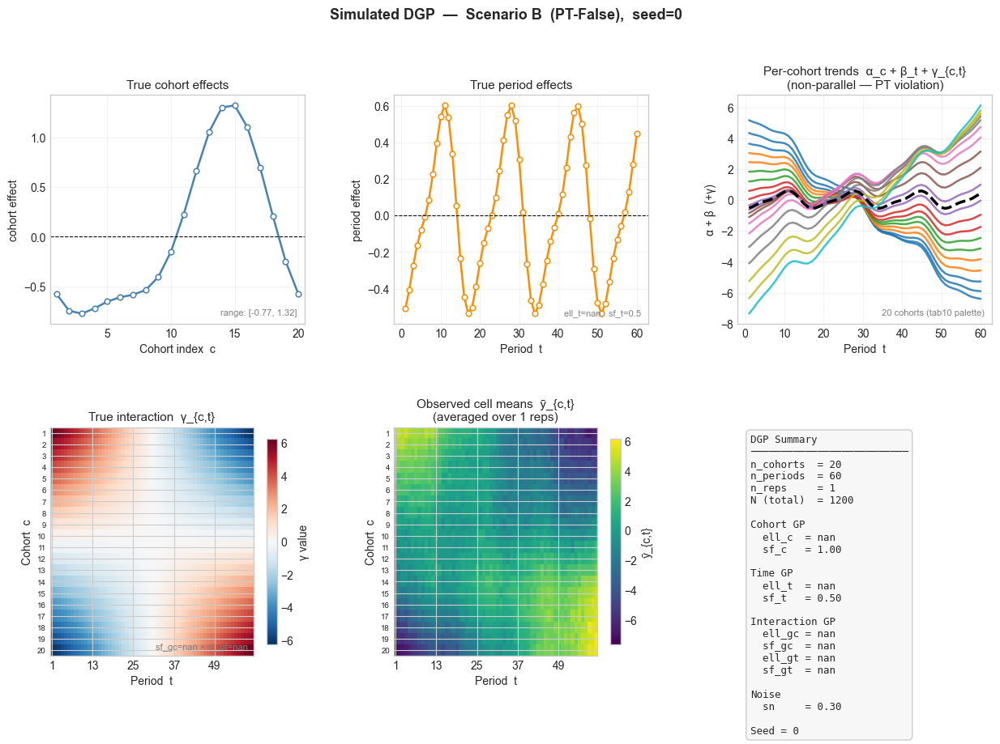

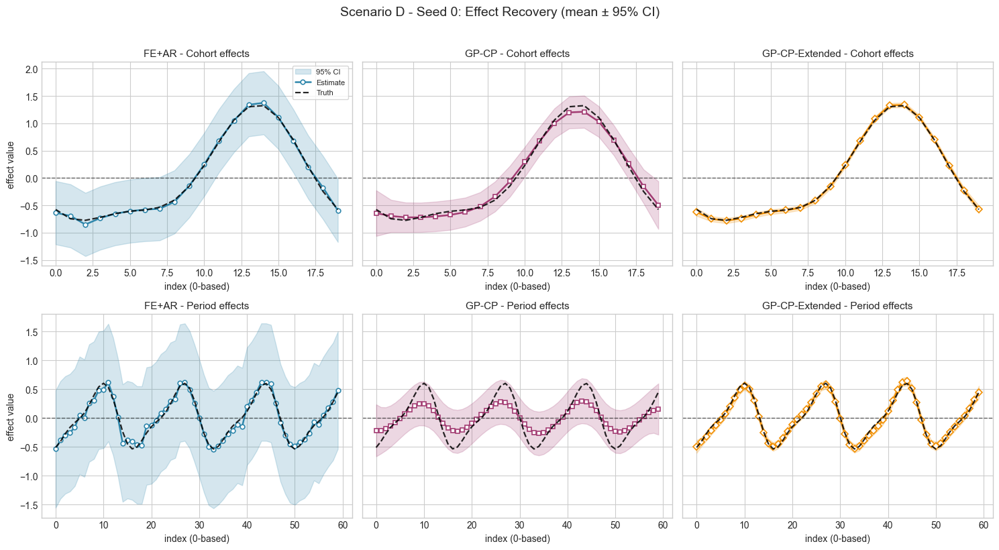

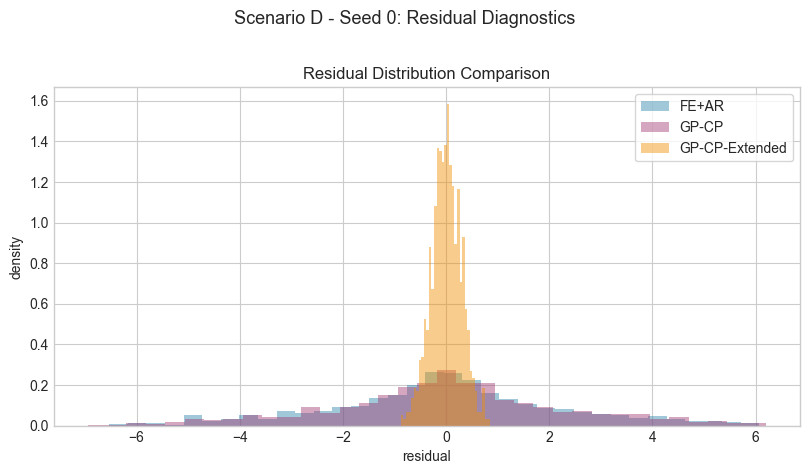

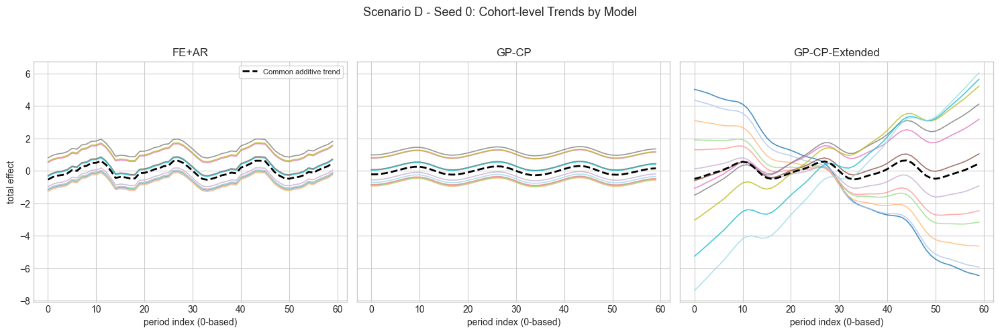

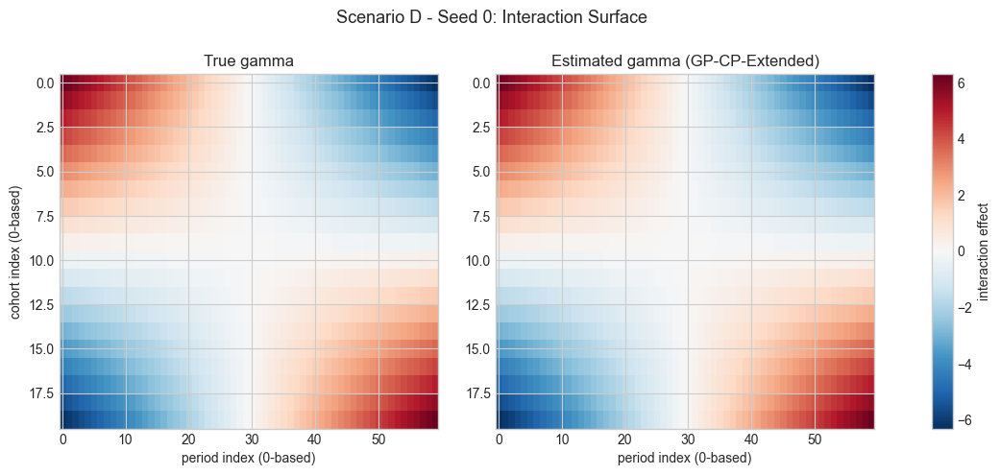

...

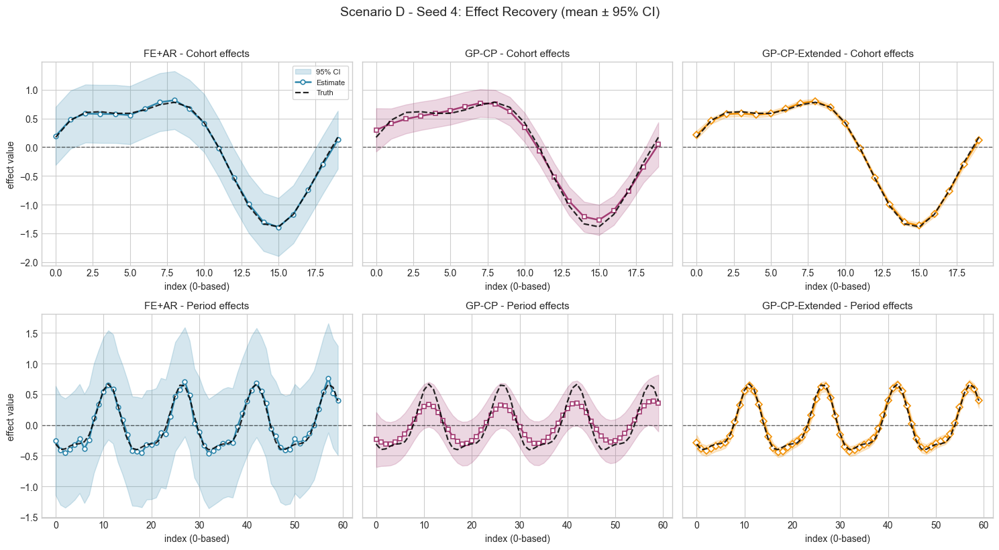

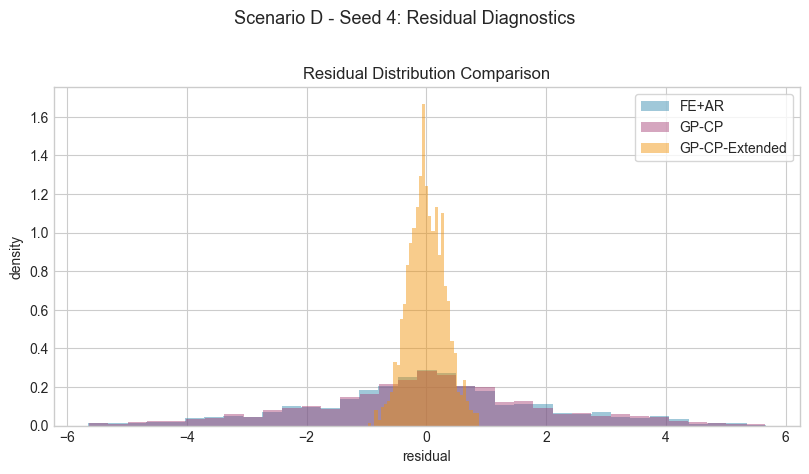

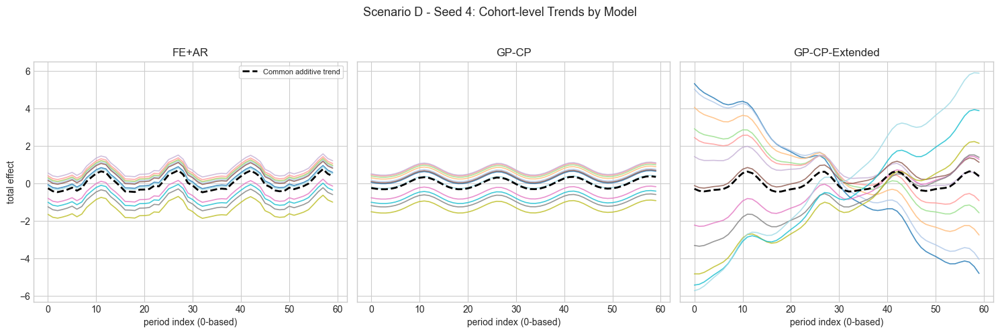

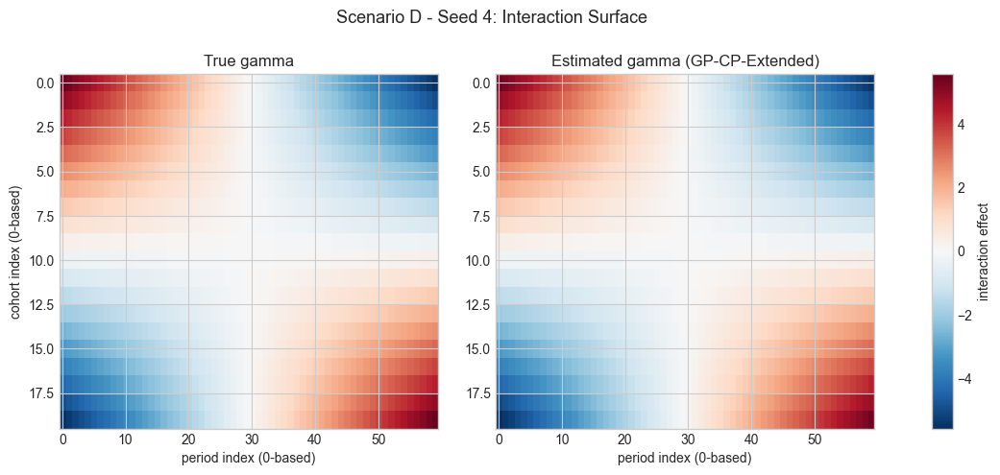

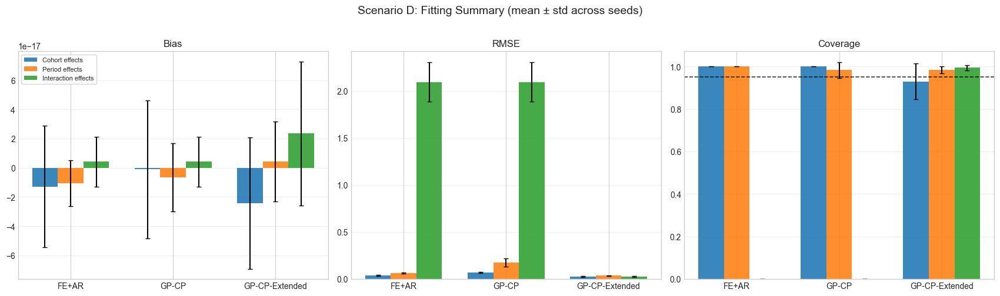

In [5]:
# D-1: full-data fit
scenD_metric_records = []

for seed in SEEDS:
 data = simulate_cohort_data2(
  n_cohorts=N_COHORTS, n_periods=N_PERIODS, n_reps=N_REPS,
  sf_c=SF_C, sf_t=SF_T, freq_t=FREQ_T,
  sf_g=SF_G, slope_g=SLOPE_G,
  sn=SN, interaction=True, seed=seed,
 )

 seed_dir = _scenario_seed_dir('D', seed)
 _write_seed_dgp_report(data, scenario_label='D', out_path=seed_dir / f'dgp_report_seed{seed}.txt')
 plot_simulated_data(data, print_config=False, save_path=str(seed_dir / f'dgp_overview_seed{seed}.pdf'))

 fitted = _fit_models_full_data(data, use_global_mean=False)
 seed_rows = []
 for model_label, model_out in fitted.items:
  seed_rows.extend(_build_fit_rows(model_label, model_out, data, include_gamma=True))
 seed_df = pd.DataFrame(seed_rows)
 seed_df.to_csv(seed_dir / f'scenD_fit_seed{seed}.csv', index=False)

 seed_metrics = _build_seed_fit_metrics(seed_df)
 seed_metrics.to_csv(seed_dir / f'scenD_fit_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenD_fit_metrics_seed{seed}.txt').write_text(seed_metrics.to_string(index=False) + '\n')

 fit_info = _fit_info_for_plots(data, fitted)
 model_cmp_df, residual_df = build_comparison_tables(fit_info, include_interaction=True)
 model_cmp_df.to_csv(seed_dir / f'model_fit_summary_seed{seed}.csv', index=False)
 residual_df.to_csv(seed_dir / f'residual_summary_seed{seed}.csv', index=False)

 plot_effect_recovery(seed_df, scenario='D', seed=seed, fit_info=fit_info,
       save_path=str(seed_dir / f'scenD_seed{seed}_effect_recovery.pdf'))

 plot_interaction_heatmap(
  gamma_true=_to_numpy(data['gamma_true']),
  gamma_hat=np.asarray(fitted['GP-CP-Extended']['gamma']),
  scenario='D', seed=seed,
  save_path=str(seed_dir / f'scenD_seed{seed}_interaction_heatmap.pdf')
 )

 scenD_metric_records.append(seed_metrics.assign(seed=seed))
 print(f'[D-1] seed={seed}: done')

scenD_fit_metrics_all = pd.concat(scenD_metric_records, ignore_index=True)
summary_scenD_fit = (
 scenD_fit_metrics_all
.groupby(['model', 'effect_type', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenD_fit.to_csv(SIM_ROOT / 'summary_scenD_fit.csv', index=False)
plot_scenario_fit_summary(summary_scenD_fit, scenario='D', save_path=str(SIM_ROOT / 'summary_scenD_fit.pdf'))
print('D-1 summary written')


Figure saved ->../results/simulations/D/0/scenD_seed0_placebo_tau_t.pdf
Figure saved ->../results/simulations/D/0/scenD_seed0_placebo_tau_ct.pdf
Figure saved ->../results/simulations/D/0/scenD_seed0_placebo_beta_diag.pdf
Figure saved ->../results/simulations/D/0/scenD_seed0_placebo_cohort_trends_3x3.pdf
Figure saved ->../results/simulations/D/0/scenD_seed0_extrapolation_beta.pdf
Figure saved ->../results/simulations/D/0/scenD_seed0_extrapolation_y.pdf
[D-2/3/4] seed=0: done
Figure saved ->../results/simulations/D/1/scenD_seed1_placebo_tau_t.pdf
Figure saved ->../results/simulations/D/1/scenD_seed1_placebo_tau_ct.pdf
Figure saved ->../results/simulations/D/1/scenD_seed1_placebo_beta_diag.pdf
Figure saved ->../results/simulations/D/1/scenD_seed1_placebo_cohort_trends_3x3.pdf
Figure saved ->../results/simulations/D/1/scenD_seed1_extrapolation_beta.pdf
Figure saved ->../results/simulations/D/1/scenD_seed1_extrapolation_y.pdf
[D-2/3/4] seed=1: done
Figure saved ->../results/simulations/D/2/

/path/to/your/project RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close`.
 fig, axes = plt.subplots(1, len(present), figsize=(5.4 * len(present), 4.8), sharey=True)


Figure saved ->../results/simulations/D/3/scenD_seed3_placebo_beta_diag.pdf
Figure saved ->../results/simulations/D/3/scenD_seed3_placebo_cohort_trends_3x3.pdf
Figure saved ->../results/simulations/D/3/scenD_seed3_extrapolation_beta.pdf
Figure saved ->../results/simulations/D/3/scenD_seed3_extrapolation_y.pdf
[D-2/3/4] seed=3: done
Figure saved ->../results/simulations/D/4/scenD_seed4_placebo_tau_t.pdf
Figure saved ->../results/simulations/D/4/scenD_seed4_placebo_tau_ct.pdf
Figure saved ->../results/simulations/D/4/scenD_seed4_placebo_beta_diag.pdf
Figure saved ->../results/simulations/D/4/scenD_seed4_placebo_cohort_trends_3x3.pdf
Figure saved ->../results/simulations/D/4/scenD_seed4_extrapolation_beta.pdf
Figure saved ->../results/simulations/D/4/scenD_seed4_extrapolation_y.pdf
[D-2/3/4] seed=4: done
D extrap summaries written


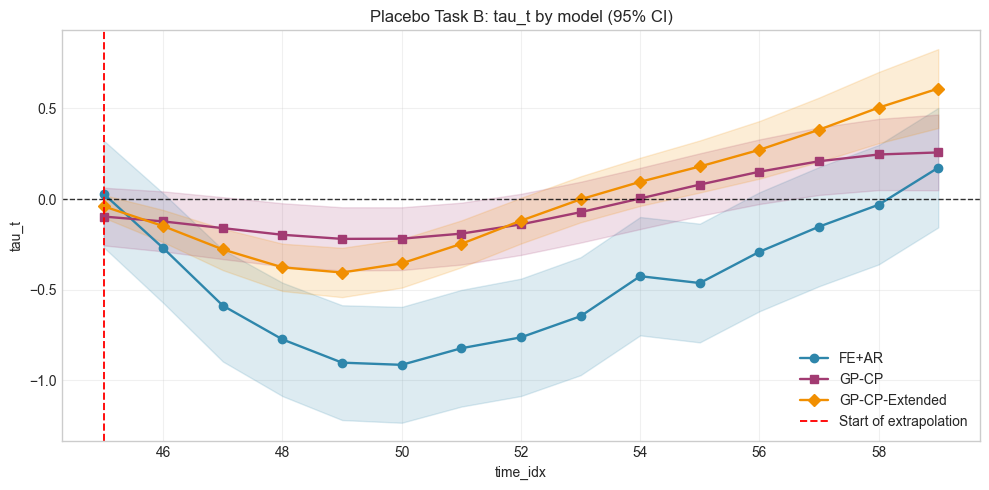

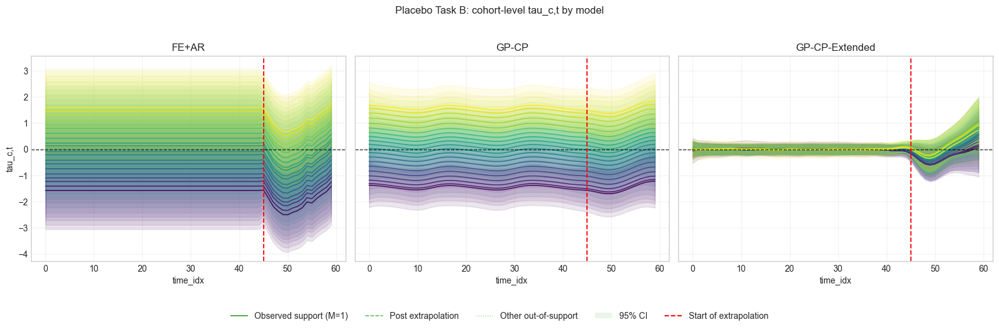

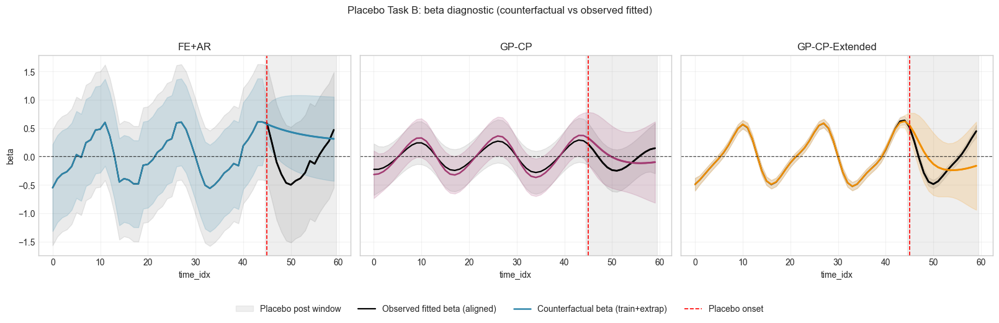

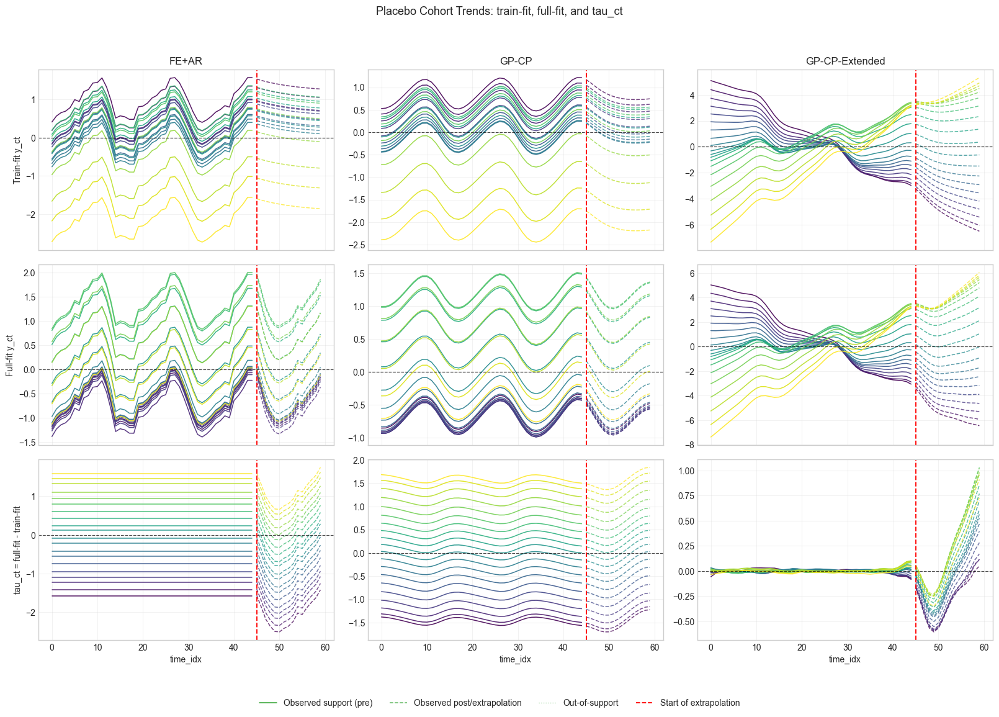

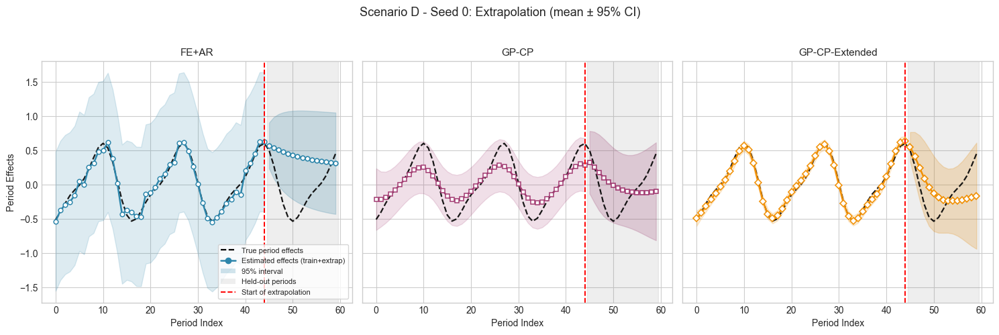

...

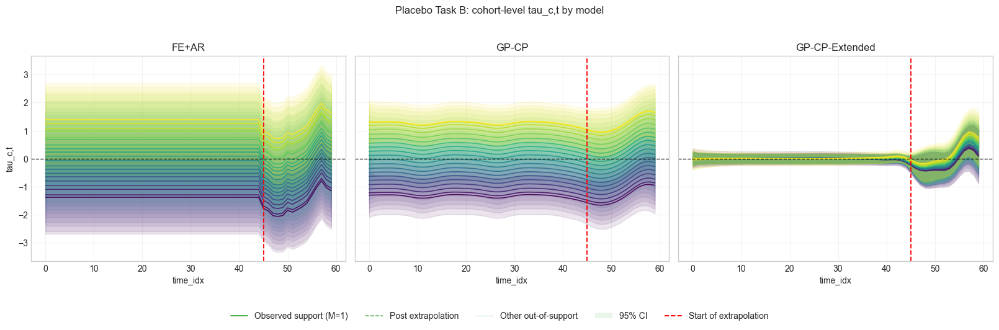

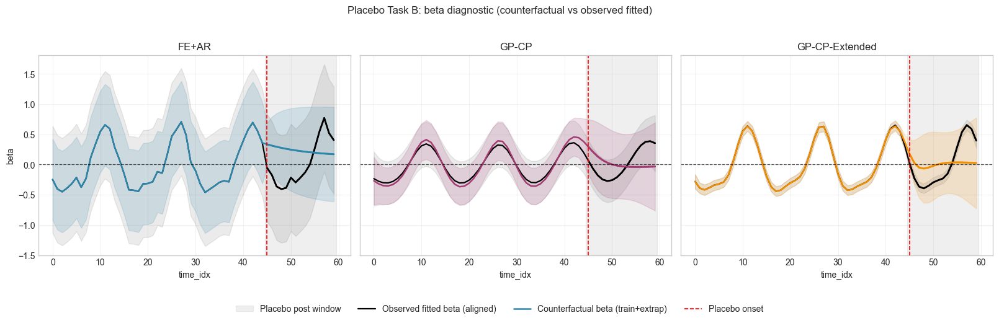

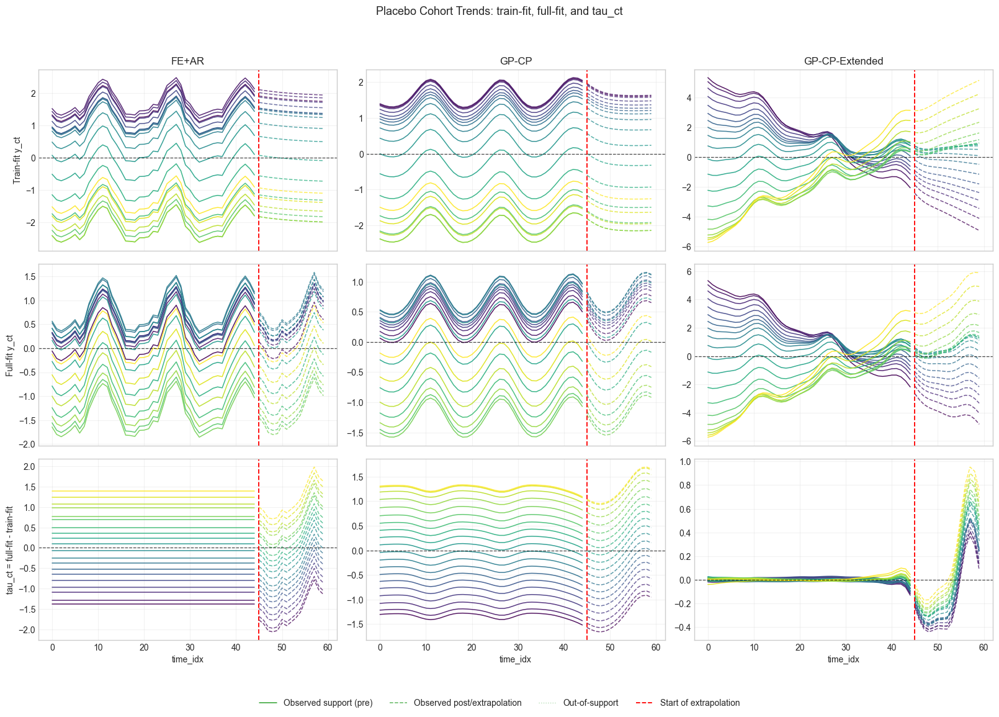

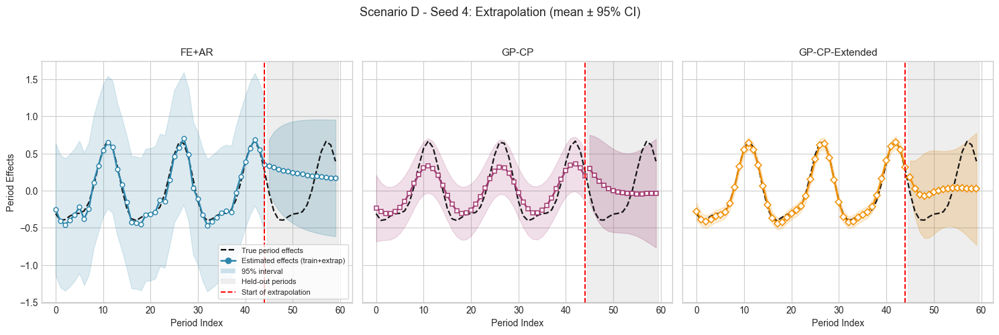

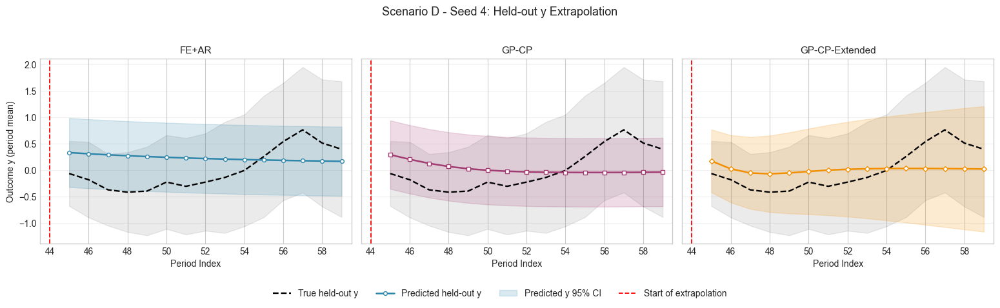

In [6]:
# D-2: extrapolation + D-3/D-4 artifacts
scenD_extrap_metric_records = []
scenD_extrap_y_metric_records = []
scenD_placebo_metric_records = []

for seed in SEEDS:
 data = simulate_cohort_data2(
  n_cohorts=N_COHORTS, n_periods=N_PERIODS, n_reps=N_REPS,
  sf_c=SF_C, sf_t=SF_T, freq_t=FREQ_T,
  sf_g=SF_G, slope_g=SLOPE_G,
  sn=SN, interaction=True, seed=seed,
 )
 seed_dir = _scenario_seed_dir('D', seed)

 obs_t = _to_numpy(data['obs_t']).astype(int)
 obs_c = _to_numpy(data['obs_c']).astype(int)
 y_all = _to_numpy(data['y']).astype(float)
 train_mask = obs_t <= TRAIN_CUTOFF
 test_mask = ~train_mask

 y_tr = y_all[train_mask]
 c_tr = obs_c[train_mask]
 t_tr = obs_t[train_mask]

 y_test = y_all[test_mask]
 c_test = obs_c[test_mask]
 t_test = obs_t[test_mask]

 t_train = TRAIN_CUTOFF + 1
 test_periods = np.arange(t_train, N_PERIODS, dtype=int)
 n_extrap = len(test_periods)
 beta_true_full = _to_numpy(data['beta_true'])
 beta_true_test = beta_true_full[test_periods]
 hp = data['hyperparams']

 fe = FixedEffectsModel(use_global_mean=False).fit(
  y=y_tr, obs_c=c_tr, obs_t=t_tr, n_cohorts=N_COHORTS, n_periods=t_train,
  seed=seed, true_hyperparams=hp,
 )
 fe_mean, fe_std = fe.extrapolate(n_extrap)

 cp = CohortPeriodModel(use_global_mean=False).fit(
  y=y_tr, obs_c=c_tr, obs_t=t_tr, n_cohorts=N_COHORTS, n_periods=N_PERIODS,
  seed=seed, true_hyperparams=hp,
 ).results_dict
 ext = CohortPeriodExtendedModel(use_global_mean=False).fit(
  y=y_tr, obs_c=c_tr, obs_t=t_tr, n_cohorts=N_COHORTS, n_periods=N_PERIODS,
  seed=seed, true_hyperparams=hp,
 ).results_dict

 model_preds = {
  'FE+AR': {'mean': np.asarray(fe_mean), 'std': np.asarray(fe_std)},
  'GP-CP': {'mean': np.asarray(cp['beta'])[test_periods], 'std': np.asarray(cp['std_beta'])[test_periods]},
  'GP-CP-Extended': {'mean': np.asarray(ext['beta'])[test_periods], 'std': np.asarray(ext['std_beta'])[test_periods]},
 }

 rows, metrics = [], []
 for model_label, pred in model_preds.items:
  mean = pred['mean']; std = pred['std']
  lo95 = mean - 1.96 * std; hi95 = mean + 1.96 * std
  for k, t in enumerate(test_periods):
   rows.append({'model': model_label, 'period': int(t), 'mean': float(mean[k]),
       'lo95': float(lo95[k]), 'hi95': float(hi95[k]), 'truth': float(beta_true_test[k])})
  m = summarise_extrapolation(pred_mean=mean, truth=beta_true_test)
  m['Coverage'] = float(np.mean((lo95 <= beta_true_test) & (beta_true_test <= hi95)))
  m['CI_Width'] = float(np.mean(hi95 - lo95))
  for metric_name, value in m.items:
   metrics.append({'model': model_label, 'metric': metric_name, 'value': float(value)})

 # Placebo TE on extrapolation window (truth is 0; simulation support M=1)
 model_order = ['FE+AR', 'GP-CP', 'GP-CP-Extended']
 support_mask_sim = np.ones((N_COHORTS, N_PERIODS), dtype=bool)

 fe_train_beta = np.concatenate([np.asarray(fe.beta_, dtype=float), np.asarray(fe_mean, dtype=float)])
 fe_train_beta_std = np.concatenate([np.asarray(fe.std_beta_, dtype=float), np.asarray(fe_std, dtype=float)])
 train_fit = {
  'FE+AR': {
   'mu': float(fe.mu_),
   'alpha': np.asarray(fe.alpha_, dtype=float),
   'beta': fe_train_beta,
   'std_alpha': np.asarray(fe.std_alpha_, dtype=float),
   'std_beta': fe_train_beta_std,
   'gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
   'std_gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
  },
  'GP-CP': {
   'mu': float(cp.get('mu', 0.0)),
   'alpha': np.asarray(cp['alpha'], dtype=float),
   'beta': np.asarray(cp['beta'], dtype=float),
   'std_alpha': np.asarray(cp.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(cp.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(cp.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(cp.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
  'GP-CP-Extended': {
   'mu': float(ext.get('mu', 0.0)),
   'alpha': np.asarray(ext['alpha'], dtype=float),
   'beta': np.asarray(ext['beta'], dtype=float),
   'std_alpha': np.asarray(ext.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(ext.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(ext.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(ext.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
 }

 fe_full = FixedEffectsModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 )
 cp_full = CohortPeriodModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict
 ext_full = CohortPeriodExtendedModel(use_global_mean=False).fit(
  y=y_all,
  obs_c=obs_c,
  obs_t=obs_t,
  n_cohorts=N_COHORTS,
  n_periods=N_PERIODS,
  seed=seed,
  true_hyperparams=hp,
 ).results_dict

 full_fit = {
  'FE+AR': {
   'mu': float(fe_full.mu_),
   'alpha': np.asarray(fe_full.alpha_, dtype=float),
   'beta': np.asarray(fe_full.beta_, dtype=float),
   'std_alpha': np.asarray(fe_full.std_alpha_, dtype=float),
   'std_beta': np.asarray(fe_full.std_beta_, dtype=float),
   'gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
   'std_gamma': np.zeros((N_COHORTS, N_PERIODS), dtype=float),
  },
  'GP-CP': {
   'mu': float(cp_full.get('mu', 0.0)),
   'alpha': np.asarray(cp_full['alpha'], dtype=float),
   'beta': np.asarray(cp_full['beta'], dtype=float),
   'std_alpha': np.asarray(cp_full.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(cp_full.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(cp_full.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(cp_full.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
  'GP-CP-Extended': {
   'mu': float(ext_full.get('mu', 0.0)),
   'alpha': np.asarray(ext_full['alpha'], dtype=float),
   'beta': np.asarray(ext_full['beta'], dtype=float),
   'std_alpha': np.asarray(ext_full.get('std_alpha', np.zeros(N_COHORTS)), dtype=float),
   'std_beta': np.asarray(ext_full.get('std_beta', np.zeros(N_PERIODS)), dtype=float),
   'gamma': np.asarray(ext_full.get('gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
   'std_gamma': np.asarray(ext_full.get('std_gamma', np.zeros((N_COHORTS, N_PERIODS))), dtype=float),
  },
 }

 tau_t_df, tau_ct_df, _ = compute_beta_placebo_te_tables(
  category=f'scenD_seed{seed}',
  train_fit=train_fit,
  full_fit=full_fit,
  n_t_tr=t_train,
  n_t=N_PERIODS,
  n_c=N_COHORTS,
  support_mask=support_mask_sim,
  model_order=model_order,
 )
 te_summary_df = summarise_placebo_estimands(
  category=f'scenD_seed{seed}',
  tau_ct_df=tau_ct_df,
  tau_t_df=tau_t_df,
  model_order=model_order,
 )
 placebo_long_df = te_summary_df.melt(id_vars=['category', 'model'], var_name='metric', value_name='value')

 tau_t_df.to_csv(seed_dir / f'scenD_placebo_tau_t_seed{seed}.csv', index=False)
 tau_ct_df.to_csv(seed_dir / f'scenD_placebo_tau_ct_seed{seed}.csv', index=False)
 te_summary_df.to_csv(seed_dir / f'scenD_placebo_summary_seed{seed}.csv', index=False)
 placebo_long_df.to_csv(seed_dir / f'scenD_placebo_metrics_long_seed{seed}.csv', index=False)

 plot_placebo_tau_t_by_model_lines_ci(
  tau_t_df=tau_t_df,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  save_path=str(seed_dir / f'scenD_seed{seed}_placebo_tau_t.pdf'),
 )
 plot_placebo_tau_ct_extended_lines_ci(
  tau_ct_df=tau_ct_df,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  save_path=str(seed_dir / f'scenD_seed{seed}_placebo_tau_ct.pdf'),
 )
 plot_placebo_beta_diagnostic_3panel(
  train_fit=train_fit,
  full_fit=full_fit,
  n_t_tr=t_train,
  n_t=N_PERIODS,
  model_order=model_order,
  save_path=str(seed_dir / f'scenD_seed{seed}_placebo_beta_diag.pdf'),
 )
 plot_placebo_cohort_trends_3x3(
  train_fit=train_fit,
  full_fit=full_fit,
  support_mask=support_mask_sim,
  model_order=model_order,
  treatment_time_idx=t_train,
  treatment_label='Start of extrapolation',
  extrapolation_start_idx=t_train,
  save_path=str(seed_dir / f'scenD_seed{seed}_placebo_cohort_trends_3x3.pdf'),
 )

 y_pred = {
  'FE+AR': fe.mu_ + fe.alpha_[c_test] + np.asarray(fe_mean, dtype=float)[t_test - t_train],
  'GP-CP': float(cp.get('mu', 0.0)) + np.asarray(cp['alpha'])[c_test] + np.asarray(cp['beta'])[t_test] + np.asarray(cp['gamma'])[c_test, t_test],
  'GP-CP-Extended': float(ext.get('mu', 0.0)) + np.asarray(ext['alpha'])[c_test] + np.asarray(ext['beta'])[t_test] + np.asarray(ext['gamma'])[c_test, t_test],
 }

 y_rows, y_metrics = [], []
 for model_label, yh in y_pred.items:
  resid = yh - y_test
  for i in range(len(y_test)):
   y_rows.append({'model': model_label, 'cohort': int(c_test[i]), 'period': int(t_test[i]),
       'y_true': float(y_test[i]), 'y_hat': float(yh[i]), 'resid': float(resid[i])})
  y_metrics.extend([
   {'model': model_label, 'metric': 'Bias', 'value': float(np.mean(resid))},
   {'model': model_label, 'metric': 'MAE', 'value': float(np.mean(np.abs(resid)))},
   {'model': model_label, 'metric': 'RMSE', 'value': float(np.sqrt(np.mean(resid ** 2)))},
  ])

 extrap_df = pd.DataFrame(rows)
 metrics_df = pd.DataFrame(metrics)
 y_df = pd.DataFrame(y_rows)
 y_metrics_df = pd.DataFrame(y_metrics)

 extrap_df.to_csv(seed_dir / f'scenD_extrap_seed{seed}.csv', index=False)
 metrics_df.to_csv(seed_dir / f'scenD_extrap_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenD_extrap_metrics_seed{seed}.txt').write_text(metrics_df.to_string(index=False) + '\n')

 y_df.to_csv(seed_dir / f'scenD_extrap_y_seed{seed}.csv', index=False)
 y_metrics_df.to_csv(seed_dir / f'scenD_extrap_y_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenD_extrap_y_metrics_seed{seed}.txt').write_text(y_metrics_df.to_string(index=False) + '\n')

 fit_df = pd.read_csv(seed_dir / f'scenD_fit_seed{seed}.csv')
 plot_extrapolation(fit_df=fit_df, extrap_df=extrap_df, beta_true_full=beta_true_full,
      train_cutoff=TRAIN_CUTOFF, scenario='D', seed=seed,
      save_path=str(seed_dir / f'scenD_seed{seed}_extrapolation_beta.pdf'))
 plot_extrapolation_y(extrap_y_df=y_df, train_cutoff=TRAIN_CUTOFF, scenario='D', seed=seed,
       save_path=str(seed_dir / f'scenD_seed{seed}_extrapolation_y.pdf'))

 seed_fit_metrics = pd.read_csv(seed_dir / f'scenD_fit_metrics_seed{seed}.csv').assign(task='fit')
 seed_ex_metrics = metrics_df.assign(task='extrapolation', effect_type='beta')
 seed_ex_y_metrics = y_metrics_df.assign(task='extrapolation_y', effect_type='y')
 if 'placebo_long_df' not in locals:
  placebo_long_df = pd.DataFrame(columns=['category', 'model', 'metric', 'value'])
 seed_placebo_metrics = placebo_long_df[['model', 'metric', 'value']].assign(task='placebo_te', effect_type='tau_att')
 seed_model_table = pd.concat([seed_fit_metrics, seed_ex_metrics, seed_ex_y_metrics, seed_placebo_metrics], ignore_index=True)
 seed_model_table.to_csv(seed_dir / f'scenD_model_metrics_seed{seed}.csv', index=False)
 (seed_dir / f'scenD_model_metrics_seed{seed}.txt').write_text(seed_model_table.to_string(index=False) + '\n')

 scenD_extrap_metric_records.append(metrics_df.assign(seed=seed))
 scenD_extrap_y_metric_records.append(y_metrics_df.assign(seed=seed))
 scenD_placebo_metric_records.append(placebo_long_df.assign(seed=seed))
 print(f'[D-2/3/4] seed={seed}: done')

scenD_extrap_metrics_all = pd.concat(scenD_extrap_metric_records, ignore_index=True)
summary_scenD_extrap = (
 scenD_extrap_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenD_extrap.to_csv(SIM_ROOT / 'summary_scenD_extrap.csv', index=False)

scenD_extrap_y_metrics_all = pd.concat(scenD_extrap_y_metric_records, ignore_index=True)
summary_scenD_extrap_y = (
 scenD_extrap_y_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenD_extrap_y.to_csv(SIM_ROOT / 'summary_scenD_extrap_y.csv', index=False)

scenD_placebo_metrics_all = pd.concat(scenD_placebo_metric_records, ignore_index=True)
summary_scenD_placebo = (
 scenD_placebo_metrics_all
.groupby(['model', 'metric'], as_index=False)['value']
.agg(mean='mean', std='std')
)
summary_scenD_placebo.to_csv(SIM_ROOT / 'summary_scenD_placebo.csv', index=False)
print('D extrap summaries written')


## Combined Summary
- Step: Merge Scenario C and D outputs into final comparison tables.
- Output: Combined metrics and figures for reporting.


Figure saved ->../results/simulations/summary_metrics_fit_barplot_CD.pdf
Figure saved ->../results/simulations/summary_metrics_extrap_beta_barplot_CD.pdf
Figure saved ->../results/simulations/summary_metrics_extrap_y_barplot_CD.pdf
Wrote:../results/simulations/summary_ALL_CD.csv
Wrote:../results/simulations/summary_metrics_fit_barplot_CD.pdf
Wrote:../results/simulations/summary_metrics_extrap_beta_barplot_CD.pdf
Wrote:../results/simulations/summary_metrics_extrap_y_barplot_CD.pdf
Wrote:../results/simulations/summary_coverage_table_fit_CD.txt
Wrote:../results/simulations/summary_coverage_table_extrap_beta_CD.txt


,scenario,task,model,effect_type,metric,mean,std
0,C,fit,FE+AR,alpha,Bias,-3.885781e-18,6.926844e-17
1,C,fit,FE+AR,alpha,CI_Width,1.487692e-01,4.170626e-03
2,C,fit,FE+AR,alpha,Coverage,9.500000e-01,3.535534e-02
3,C,fit,FE+AR,alpha,RMSE,3.708650e-02,6.813323e-03
4,C,fit,FE+AR,beta,Bias,-9.992007e-18,1.311616e-17
5,C,fit,FE+AR,beta,CI_Width,2.621574e-01,7.349376e-03
6,C,fit,FE+AR,beta,Coverage,9.633333e-01,2.738613e-02
7,C,fit,FE+AR,beta,RMSE,6.412522e-02,6.440466e-03
8,C,fit,FE+AR,gamma,Bias,NaN,NaN
9,C,fit,FE+AR,gamma,Coverage,NaN,NaN


Figure saved ->../results/simulations/summary_metrics_placebo_tau_barplot_CD.pdf
Figure saved ->../results/simulations/summary_metrics_placebo_att_barplot_CD.pdf
Wrote:../results/simulations/summary_metrics_placebo_tau_barplot_CD.pdf
Wrote:../results/simulations/summary_metrics_placebo_att_barplot_CD.pdf
Wrote:../results/simulations/summary_placebo_table_CD.csv
Wrote:../results/simulations/summary_placebo_table_CD.txt


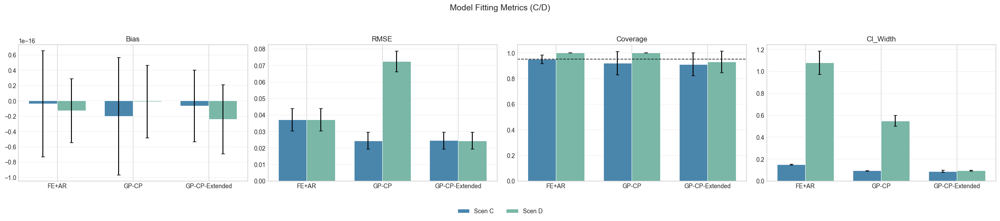

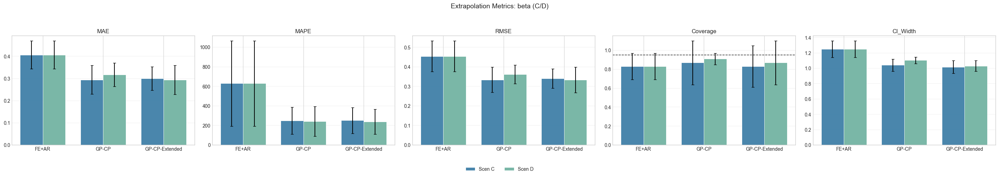

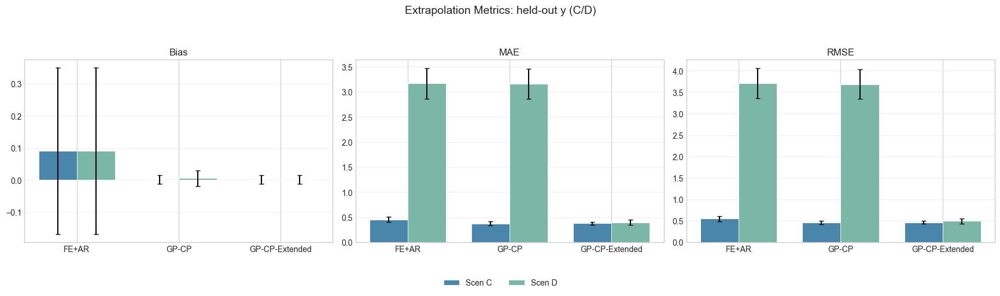

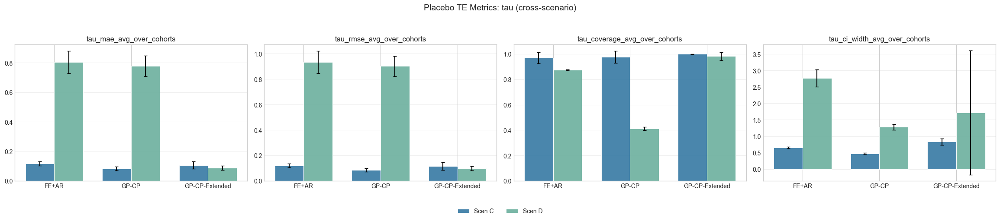

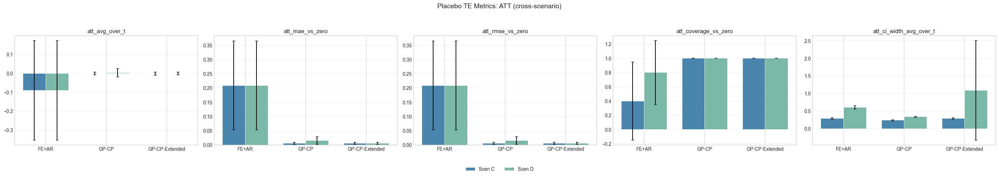

In [7]:
# Combine C/D summaries + final summary plots
if 'summary_scenC_fit' not in globals:
 summary_scenC_fit = pd.read_csv(SIM_ROOT / 'summary_scenC_fit.csv')
if 'summary_scenC_extrap' not in globals:
 summary_scenC_extrap = pd.read_csv(SIM_ROOT / 'summary_scenC_extrap.csv')
if 'summary_scenC_extrap_y' not in globals:
 summary_scenC_extrap_y = pd.read_csv(SIM_ROOT / 'summary_scenC_extrap_y.csv')
if 'summary_scenD_fit' not in globals:
 summary_scenD_fit = pd.read_csv(SIM_ROOT / 'summary_scenD_fit.csv')
if 'summary_scenD_extrap' not in globals:
 summary_scenD_extrap = pd.read_csv(SIM_ROOT / 'summary_scenD_extrap.csv')
if 'summary_scenD_extrap_y' not in globals:
 summary_scenD_extrap_y = pd.read_csv(SIM_ROOT / 'summary_scenD_extrap_y.csv')
if 'summary_scenC_placebo' not in globals:
 summary_scenC_placebo = pd.read_csv(SIM_ROOT / 'summary_scenC_placebo.csv')
if 'summary_scenD_placebo' not in globals:
 summary_scenD_placebo = pd.read_csv(SIM_ROOT / 'summary_scenD_placebo.csv')

parts = []
parts.append(summary_scenC_fit.assign(scenario='C', task='fit'))
parts.append(summary_scenC_extrap.assign(scenario='C', task='extrapolation', effect_type='beta'))
parts.append(summary_scenC_extrap_y.assign(scenario='C', task='extrapolation_y', effect_type='y'))
parts.append(summary_scenD_fit.assign(scenario='D', task='fit'))
parts.append(summary_scenD_extrap.assign(scenario='D', task='extrapolation', effect_type='beta'))
parts.append(summary_scenD_extrap_y.assign(scenario='D', task='extrapolation_y', effect_type='y'))
parts.append(summary_scenC_placebo.assign(scenario='C', task='placebo_te', effect_type='tau_att'))
parts.append(summary_scenD_placebo.assign(scenario='D', task='placebo_te', effect_type='tau_att'))

summary_cd = pd.concat(parts, ignore_index=True)
summary_cd = summary_cd[['scenario','task','model','effect_type','metric','mean','std']]
summary_cd.to_csv(SIM_ROOT / 'summary_ALL_CD.csv', index=False)

from src.visualization import plot_metric_summary

fit_df = summary_cd[summary_cd['task'].astype(str) == 'fit'].copy
ex_beta_df = summary_cd[summary_cd['task'].astype(str) == 'extrapolation'].copy
ex_y_df = summary_cd[summary_cd['task'].astype(str) == 'extrapolation_y'].copy

plot_metric_summary(fit_df, task='fit', metrics=['Bias','RMSE','Coverage','CI_Width'],
     title='Model Fitting Metrics (C/D)',
     save_path=str(SIM_ROOT / 'summary_metrics_fit_barplot_CD.pdf'))
plot_metric_summary(ex_beta_df, task='extrapolation', metrics=['MAE','MAPE','RMSE','Coverage','CI_Width'],
     title='Extrapolation Metrics: beta (C/D)',
     save_path=str(SIM_ROOT / 'summary_metrics_extrap_beta_barplot_CD.pdf'))
plot_metric_summary(ex_y_df, task='extrapolation_y', metrics=['Bias','MAE','RMSE'],
     title='Extrapolation Metrics: held-out y (C/D)',
     save_path=str(SIM_ROOT / 'summary_metrics_extrap_y_barplot_CD.pdf'))

# Save coverage tables as TXT instead of PDF
cov_fit = fit_df[fit_df['metric'] == 'Coverage'].copy
cov_fit_tbl = cov_fit.pivot_table(index=['model', 'effect_type'], columns='scenario', values='mean', aggfunc='first').sort_index
(SIM_ROOT / 'summary_coverage_table_fit_CD.txt').write_text(cov_fit_tbl.to_string + "\n")

cov_exb = ex_beta_df[ex_beta_df['metric'] == 'Coverage'].copy
cov_exb_tbl = cov_exb.pivot_table(index=['model', 'effect_type'], columns='scenario', values='mean', aggfunc='first').sort_index
(SIM_ROOT / 'summary_coverage_table_extrap_beta_CD.txt').write_text(cov_exb_tbl.to_string + "\n")

print('Wrote:', SIM_ROOT / 'summary_ALL_CD.csv')
print('Wrote:', SIM_ROOT / 'summary_metrics_fit_barplot_CD.pdf')
print('Wrote:', SIM_ROOT / 'summary_metrics_extrap_beta_barplot_CD.pdf')
print('Wrote:', SIM_ROOT / 'summary_metrics_extrap_y_barplot_CD.pdf')
print('Wrote:', SIM_ROOT / 'summary_coverage_table_fit_CD.txt')
print('Wrote:', SIM_ROOT / 'summary_coverage_table_extrap_beta_CD.txt')
display(summary_cd.head(30))

# Placebo-only cross-scenario summaries (tau/ATT)
placebo_df = summary_cd[summary_cd['task'].astype(str) == 'placebo_te'].copy
if not placebo_df.empty:
 tau_metrics = [
  'tau_mae_avg_over_cohorts',
  'tau_rmse_avg_over_cohorts',
  'tau_coverage_avg_over_cohorts',
  'tau_ci_width_avg_over_cohorts',
 ]
 att_metrics = [
  'att_avg_over_t',
  'att_mae_vs_zero',
  'att_rmse_vs_zero',
  'att_coverage_vs_zero',
  'att_ci_width_avg_over_t',
 ]

 tau_df = placebo_df[placebo_df['metric'].astype(str).isin(tau_metrics)].copy
 att_df = placebo_df[placebo_df['metric'].astype(str).isin(att_metrics)].copy

 if not tau_df.empty:
  plot_metric_summary(
   tau_df,
   task='placebo_te',
   metrics=tau_metrics,
   title='Placebo TE Metrics: tau (cross-scenario)',
   save_path=str(SIM_ROOT / 'summary_metrics_placebo_tau_barplot_CD.pdf'),
  )

 if not att_df.empty:
  plot_metric_summary(
   att_df,
   task='placebo_te',
   metrics=att_metrics,
   title='Placebo TE Metrics: ATT (cross-scenario)',
   save_path=str(SIM_ROOT / 'summary_metrics_placebo_att_barplot_CD.pdf'),
  )

 summary_placebo_table_cd = (
  placebo_df
 .pivot_table(index=['model', 'metric'], columns='scenario', values='mean', aggfunc='first')
 .sort_index
 )
 summary_placebo_table_cd.to_csv(SIM_ROOT / 'summary_placebo_table_CD.csv')
 (SIM_ROOT / 'summary_placebo_table_CD.txt').write_text(summary_placebo_table_cd.to_string + "\n")

 print('Wrote:', SIM_ROOT / 'summary_metrics_placebo_tau_barplot_CD.pdf')
 print('Wrote:', SIM_ROOT / 'summary_metrics_placebo_att_barplot_CD.pdf')
 print('Wrote:', SIM_ROOT / 'summary_placebo_table_CD.csv')
 print('Wrote:', SIM_ROOT / 'summary_placebo_table_CD.txt')


Figure saved ->../results/simulations/summary_metrics_fit_barplot_CD.pdf
Figure saved ->../results/simulations/summary_metrics_extrap_barplot_CD.pdf
Figure saved ->../results/simulations/summary_coverage_table_fit_CD.pdf
Figure saved ->../results/simulations/summary_coverage_table_extrap_CD.pdf
Wrote:../results/simulations/summary_ALL_CD.csv
Wrote:../results/simulations/summary_metrics_fit_barplot_CD.pdf
Wrote:../results/simulations/summary_metrics_extrap_barplot_CD.pdf
Wrote:../results/simulations/summary_coverage_table_fit_CD.pdf
Wrote:../results/simulations/summary_coverage_table_extrap_CD.pdf


,scenario,task,model,effect_type,metric,mean,std
0,C,fit,FE+AR,alpha,Bias,-3.885781e-18,6.926844e-17
1,C,fit,FE+AR,alpha,CI_Width,1.487692e-01,4.170626e-03
2,C,fit,FE+AR,alpha,Coverage,9.500000e-01,3.535534e-02
3,C,fit,FE+AR,alpha,RMSE,3.708650e-02,6.813323e-03
4,C,fit,FE+AR,beta,Bias,-9.992007e-18,1.311616e-17
5,C,fit,FE+AR,beta,CI_Width,2.621574e-01,7.349376e-03
6,C,fit,FE+AR,beta,Coverage,9.633333e-01,2.738613e-02
7,C,fit,FE+AR,beta,RMSE,6.412522e-02,6.440466e-03
8,C,fit,FE+AR,gamma,Bias,NaN,NaN
9,C,fit,FE+AR,gamma,Coverage,NaN,NaN


Figure saved ->../results/simulations/summary_metrics_placebo_tau_barplot_CD.pdf
Figure saved ->../results/simulations/summary_metrics_placebo_att_barplot_CD.pdf
Wrote:../results/simulations/summary_metrics_placebo_tau_barplot_CD.pdf
Wrote:../results/simulations/summary_metrics_placebo_att_barplot_CD.pdf
Wrote:../results/simulations/summary_placebo_table_CD.csv
Wrote:../results/simulations/summary_placebo_table_CD.txt


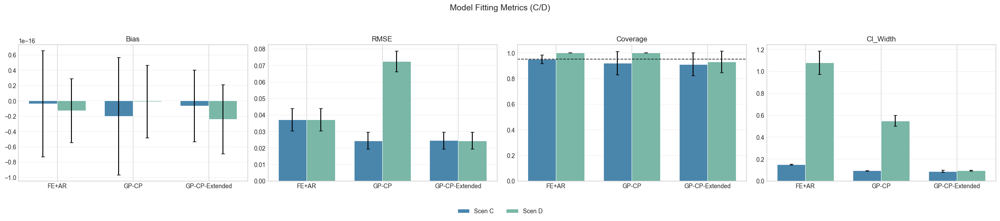

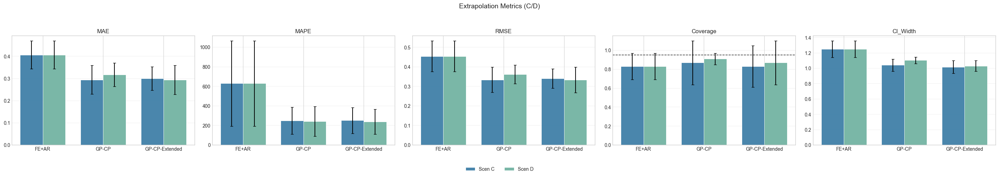

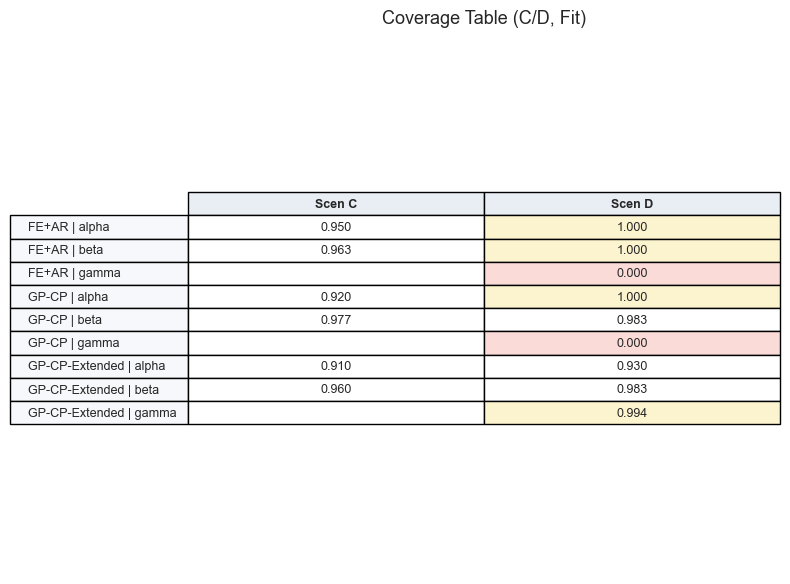

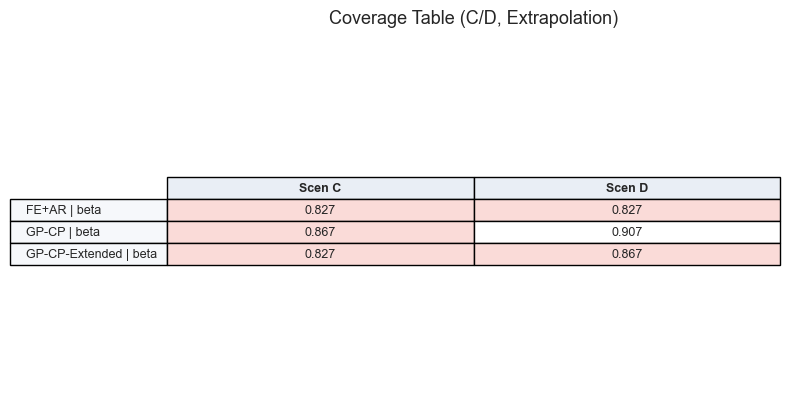

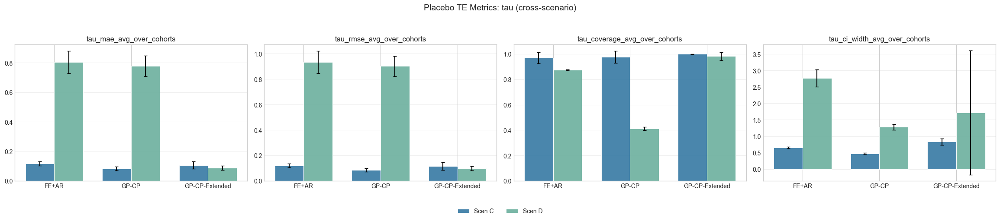

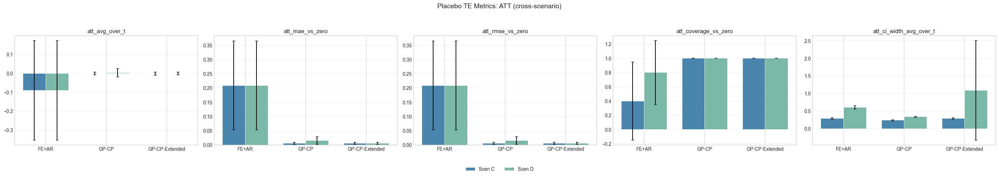

In [8]:
# Combine C/D summaries + final summary plots
if 'summary_scenC_fit' not in globals:
 summary_scenC_fit = pd.read_csv(SIM_ROOT / 'summary_scenC_fit.csv')
if 'summary_scenC_extrap' not in globals:
 summary_scenC_extrap = pd.read_csv(SIM_ROOT / 'summary_scenC_extrap.csv')
if 'summary_scenD_fit' not in globals:
 summary_scenD_fit = pd.read_csv(SIM_ROOT / 'summary_scenD_fit.csv')
if 'summary_scenD_extrap' not in globals:
 summary_scenD_extrap = pd.read_csv(SIM_ROOT / 'summary_scenD_extrap.csv')
if 'summary_scenC_placebo' not in globals:
 summary_scenC_placebo = pd.read_csv(SIM_ROOT / 'summary_scenC_placebo.csv')
if 'summary_scenD_placebo' not in globals:
 summary_scenD_placebo = pd.read_csv(SIM_ROOT / 'summary_scenD_placebo.csv')

parts = []
parts.append(summary_scenC_fit.assign(scenario='C', task='fit'))
parts.append(summary_scenC_extrap.assign(scenario='C', task='extrapolation', effect_type='beta'))
parts.append(summary_scenD_fit.assign(scenario='D', task='fit'))
parts.append(summary_scenD_extrap.assign(scenario='D', task='extrapolation', effect_type='beta'))
parts.append(summary_scenC_placebo.assign(scenario='C', task='placebo_te', effect_type='tau_att'))
parts.append(summary_scenD_placebo.assign(scenario='D', task='placebo_te', effect_type='tau_att'))

summary_cd = pd.concat(parts, ignore_index=True)
summary_cd = summary_cd[['scenario','task','model','effect_type','metric','mean','std']]
summary_cd.to_csv(SIM_ROOT / 'summary_ALL_CD.csv', index=False)

from src.visualization import plot_metric_summary, plot_coverage_table

fit_df = summary_cd[summary_cd['task'].astype(str) == 'fit'].copy
ex_df = summary_cd[summary_cd['task'].astype(str) == 'extrapolation'].copy

plot_metric_summary(
 fit_df,
 task='fit',
 metrics=['Bias', 'RMSE', 'Coverage', 'CI_Width'],
 title='Model Fitting Metrics (C/D)',
 save_path=str(SIM_ROOT / 'summary_metrics_fit_barplot_CD.pdf'),
)

plot_metric_summary(
 ex_df,
 task='extrapolation',
 metrics=['MAE', 'MAPE', 'RMSE', 'Coverage', 'CI_Width'],
 title='Extrapolation Metrics (C/D)',
 save_path=str(SIM_ROOT / 'summary_metrics_extrap_barplot_CD.pdf'),
)

plot_coverage_table(
 fit_df,
 task='fit',
 title='Coverage Table (C/D, Fit)',
 save_path=str(SIM_ROOT / 'summary_coverage_table_fit_CD.pdf'),
)

plot_coverage_table(
 ex_df,
 task='extrapolation',
 title='Coverage Table (C/D, Extrapolation)',
 save_path=str(SIM_ROOT / 'summary_coverage_table_extrap_CD.pdf'),
)

print('Wrote:', SIM_ROOT / 'summary_ALL_CD.csv')
print('Wrote:', SIM_ROOT / 'summary_metrics_fit_barplot_CD.pdf')
print('Wrote:', SIM_ROOT / 'summary_metrics_extrap_barplot_CD.pdf')
print('Wrote:', SIM_ROOT / 'summary_coverage_table_fit_CD.pdf')
print('Wrote:', SIM_ROOT / 'summary_coverage_table_extrap_CD.pdf')
display(summary_cd.head(30))

# Placebo-only cross-scenario summaries (tau/ATT)
placebo_df = summary_cd[summary_cd['task'].astype(str) == 'placebo_te'].copy
if not placebo_df.empty:
 tau_metrics = [
  'tau_mae_avg_over_cohorts',
  'tau_rmse_avg_over_cohorts',
  'tau_coverage_avg_over_cohorts',
  'tau_ci_width_avg_over_cohorts',
 ]
 att_metrics = [
  'att_avg_over_t',
  'att_mae_vs_zero',
  'att_rmse_vs_zero',
  'att_coverage_vs_zero',
  'att_ci_width_avg_over_t',
 ]

 tau_df = placebo_df[placebo_df['metric'].astype(str).isin(tau_metrics)].copy
 att_df = placebo_df[placebo_df['metric'].astype(str).isin(att_metrics)].copy

 if not tau_df.empty:
  plot_metric_summary(
   tau_df,
   task='placebo_te',
   metrics=tau_metrics,
   title='Placebo TE Metrics: tau (cross-scenario)',
   save_path=str(SIM_ROOT / 'summary_metrics_placebo_tau_barplot_CD.pdf'),
  )

 if not att_df.empty:
  plot_metric_summary(
   att_df,
   task='placebo_te',
   metrics=att_metrics,
   title='Placebo TE Metrics: ATT (cross-scenario)',
   save_path=str(SIM_ROOT / 'summary_metrics_placebo_att_barplot_CD.pdf'),
  )

 summary_placebo_table_cd = (
  placebo_df
 .pivot_table(index=['model', 'metric'], columns='scenario', values='mean', aggfunc='first')
 .sort_index
 )
 summary_placebo_table_cd.to_csv(SIM_ROOT / 'summary_placebo_table_CD.csv')
 (SIM_ROOT / 'summary_placebo_table_CD.txt').write_text(summary_placebo_table_cd.to_string + "\n")

 print('Wrote:', SIM_ROOT / 'summary_metrics_placebo_tau_barplot_CD.pdf')
 print('Wrote:', SIM_ROOT / 'summary_metrics_placebo_att_barplot_CD.pdf')
 print('Wrote:', SIM_ROOT / 'summary_placebo_table_CD.csv')
 print('Wrote:', SIM_ROOT / 'summary_placebo_table_CD.txt')
